In [1]:
%load_ext autoreload
%autoreload 2
import os
import glob
import pickle
import matplotlib.pyplot as plt
import numpy as np

* TODO: distance entre data et true au cours des sous-blocs pour regarder l'appentissage
* TODO: équaliser sujet par sujet
* TODO: équaliser aussi les résultats obtenus par le modèle

In [2]:
%matplotlib inline
fig_width = 15

from aSPEM import Analysis
import bayesianchangepoint as bcp

In [3]:
list_sujet = ['AM','BMC','CS','DC','FM','IP','LB','OP','RS','SR','TN','YK']
nb_sujet = len(list_sujet)

In [4]:
liste = []
for fname in glob.glob('data/*pkl'):
    a = fname.split('/')[1].split('.')[0].split('_')
    liste.append(a)
            
BET = {}
for x in range(len(liste)) :
    if liste[x][0]=='pari' and liste[x][1] in list_sujet:
        a = 'data/%s_%s_%s_%s.pkl'%(liste[x][0], liste[x][1],liste[x][2],liste[x][3])
        with open(a, 'rb') as fichier :
            b = pickle.load(fichier, encoding='latin1')
            BET[liste[x][1]] = b

In [5]:
e = Analysis(observer='AM', mode='enregistrement')
Full = e.Full_list(modes_bcp=None)

# Scaling Data

In [6]:
file = os.path.join('parametre', 'Data_Scaling.pkl')
with open(file, 'rb') as fichier:
    new_data = pickle.load(fichier, encoding='latin1')

In [7]:
new_bet_full = new_data['new_bet_full']
new_bet_sujet = new_data['new_bet_sujet']
new_va_full = new_data['new_va_full']
new_va_sujet = new_data['new_va_sujet']

# Variation de h

In [8]:
file = os.path.join('parametre', 'list_h_LOG.pkl')
with open(file, 'rb') as fichier:
    liste_h = pickle.load(fichier, encoding='latin1')

In [9]:
h_bet_full = liste_h['h_bet_full']
h_va_full = liste_h['h_va_full']
h_bet_sujet = liste_h['h_bet_sujet']
h_va_sujet = liste_h['h_va_sujet']

## evaluating the best hazard rate using a likelihood score between the predicted biases using different values of the hazard rate

In [10]:
def KL_distance(p_data, p_hat):
    distance = p_hat * np.log2(p_hat) - p_hat * np.log2(p_data + 1.*(p_data==0.))
    distance += (1-p_hat) * np.log2(1-p_hat) - (1-p_hat) * np.log2(1-p_data + 1.*(p_data==1.))
    return distance

In [11]:
def plot_evaluating(ax, h_eval, data, trials, bino, p, mode):

    Jeffreys = True
    p0, r0 = .5, 2. - Jeffreys
    
    distance = np.zeros(len(trials))
    p_hat = np.zeros(len(trials))
    p_low, p_sup = np.zeros_like(distance), np.zeros_like(distance)
    
    
    p_bar, r, beliefs = bcp.inference(bino, h=h_eval, p0=p0, r0=r0, verbose=False)
    p_hat, r_hat = bcp.readout(p_bar, r, beliefs, mode=mode, p0=p0)
    from scipy.stats import beta
    for trial in range(len(trials)):
        a = p_hat[trial]*(r_hat[trial])
        b = (1-p_hat[trial])*(r_hat[trial])
        rv = beta(a, b)
        p_low[trial], p_sup[trial] = rv.ppf([.05, .95])
        distance[trial] = KL_distance(data[trial], p_hat[trial])

    distance = np.exp(-distance/np.median(distance))

    ax.step(trials, data, c='k', lw=1, alpha=.9)
    ax.plot(trials, p_hat, 'r', lw=1, alpha=.5)
    ax.scatter(trials, p_hat, c=distance, vmin=distance.min(), vmax=distance.max(), alpha=1., cmap=plt.get_cmap('RdGy'))  # coolwarm

    ax.fill_between(trials, np.zeros_like(p), p, lw=.5, alpha=0.2, facecolor='k', step='pre')
    ax.fill_between(trials, p_sup, p_low, lw=.2, alpha=0.2, facecolor='r', step='mid')
    ax.plot(trials, p_sup, 'r--', lw=1, alpha=.9)
    ax.plot(trials, p_low, 'r--', lw=1, alpha=.9)
    ax.set_ylim(-0.1, 1.2)
    
    return ax

In [12]:
def find_best_h(ax, data, bino, h_sujet, mode, N_scan):
    
    Jeffreys = True
    p0, r0 = .5, 2. - Jeffreys
    
    hs = np.logspace(-1, 1, N_scan, base=N_scan)/N_scan

    full_distance = np.zeros(N_scan)
    for i_scan, h_ in enumerate(hs):
        p_bar, r, beliefs = bcp.inference(bino, h=h_, p0=p0, r0=r0, verbose=False)
        p_hat, r_hat = bcp.readout(p_bar, r, beliefs, mode=mode, p0=p0)
        d_ = KL_distance(np.array(data), p_hat)

        full_distance[i_scan] = np.mean(d_)

    ax.plot(hs, full_distance, 'k')
    ax.vlines(h_sujet, ymin=np.nanmin(full_distance), ymax=np.nanmax(full_distance), colors='k', linestyle='--', lw=2)

    h_opt = hs[np.argmin(full_distance)]
    ax.vlines(h_opt, ymin=np.nanmin(full_distance), ymax=np.nanmax(full_distance), colors='r', linestyle='--', lw=2)
    ax.set_xscale("log")
    ax.set_ylim(0)
    ax.set_xlabel('Hazard rate')
    ax.set_ylabel('distance')
    return ax, h_opt

In [13]:
import matplotlib.gridspec as gridspec

def evaluating (data_sujet, data_full, h_sujet, h_full, show='h_block'):
    
    
    for x, sujet in enumerate(list_sujet) :
        print(sujet)

        fig = plt.figure(figsize=(30,30/2))
        axs = gridspec.GridSpec(3, 2, hspace=0.2)

        mode = 'mean'

        N_trials, N_blocks = BET[sujet]['N_trials'], BET[sujet]['N_blocks']

        tau_true = 40. # N_trials/10.
        h_true = 1./tau_true
  
        for y in range(2) :
            if y==0 :
                data_eval, h_eval = data_sujet, h_sujet
                titre = 'scalling sujet'
            else :
                data_eval, h_eval = data_full, h_full
                titre = 'scalling full'
            print('\n%s'%(titre))
            
            nb_trial = 0
            l=0
            for block in range(N_blocks) :
                
                bino = np.array(list(Full['bino'][Full.sujet==sujet])[nb_trial:N_trials+nb_trial*block])
                p = np.array(list(Full['proba'][Full.sujet==sujet])[nb_trial:N_trials+nb_trial*block])
                
                print('block', block, end='')
                gs1 = gridspec.GridSpecFromSubplotSpec(2, 3, subplot_spec=axs[2*block+y], wspace=0.5)
                ax1 = plt.Subplot(fig, gs1[0,:-1])
                ax2 = plt.Subplot(fig, gs1[:,-1])
                ax3 = plt.Subplot(fig, gs1[1,:-1])
                fig.add_subplot(ax1)
                fig.add_subplot(ax3)
                
                if show=='h_block' :
                    fig.add_subplot(ax2)
                    data = data_eval[sujet][block]
                    h_fit = h_eval['block'][sujet][block]

                    trials = range(len(data))
                    ax1 = plot_evaluating(ax1, h_fit, data, trials, bino, p, mode)
                    ax1.set_ylabel('tau_fit=%.1f'%(1/h_fit))

                    ax2, h_opt = find_best_h(ax2, data, bino, h_fit, mode, N_scan=100)

                    ax3 = plot_evaluating(ax3, h_opt, data, trials, bino, p, mode)
                    ax3.set_ylabel('tau_opt=%.1f'%(1/h_opt))
                    print(' --> tau_fit=%.1f ,'%(1/h_fit), 'h_fit=%.5f ,'%(h_fit), 'tau_opt=%.1f ,'%(1/h_opt), 'h_opt=%.5f'%(h_opt))

                if show=='h_pause' :
                    gs2 = gridspec.GridSpecFromSubplotSpec(2, 2, subplot_spec=ax2, wspace=0.4, hspace=0.4)
                    
                    liste = [0,50,100,150,200]
                    
                    for a in range(len(liste)-1) :
                        print('\npause', a, end='')
                        ax4 = plt.Subplot(fig, gs2[a])
                        fig.add_subplot(ax4)
                        
                        data = data_eval[sujet][block][liste[a]:liste[a+1]]
                        h_fit = h_eval['pause'][sujet][l]
                        bibi = bino[liste[a]:liste[a+1]]
                        pp = p[liste[a]:liste[a+1]]
                        
                        trials = range(liste[a], liste[a+1])
                        ax1 = plot_evaluating(ax1, h_fit, data, trials, bibi, pp, mode)
                        ax1.set_ylabel('tau_fit')
                        ax1.text(liste[a]+(liste[a+1]-liste[a])/2, 1.1, '%.1f'%(1/h_fit))
                        
                        ax4, h_opt = find_best_h(ax4, data, bibi, h_fit, mode, N_scan=100)
                        ax4.set_title(a)
                        ax4.set_ylabel('')
                        ax4.set_xlabel('')
                        
                        ax3 = plot_evaluating(ax3, h_opt, data, trials, bibi, pp, mode)
                        ax3.set_ylabel('tau_opt')
                        ax3.text((liste[a+1]-liste[a])/2, 1.1, '%.1f'%(1/h_opt))
                        
                        
                        if a==3:
                            end='\n'
                        else :
                            end=''
                        
                        print(' --> tau_fit=%.1f ,'%(1/h_fit), 'h_fit=%.5f ,'%(h_fit), 'tau_opt=%.1f ,'%(1/h_opt), 'h_opt=%.5f'%(h_opt), end=end)
                        l=l+1

                if block==0 :
                    ax1.set_title(titre)

                nb_trial = nb_trial+N_trials

        plt.show() 

### BET

AM

scalling sujet
block 0 --> tau_fit=1363.4 , h_fit=0.00073 , tau_opt=890.2 , h_opt=0.00112
block 1 --> tau_fit=1484.1 , h_fit=0.00067 , tau_opt=1873.8 , h_opt=0.00053
block 2 --> tau_fit=271.5 , h_fit=0.00368 , tau_opt=200.9 , h_opt=0.00498

scalling full
block 0 --> tau_fit=1725.7 , h_fit=0.00058 , tau_opt=1873.8 , h_opt=0.00053
block 1 --> tau_fit=2.6 , h_fit=0.37987 , tau_opt=4.0 , h_opt=0.24771
block 2 --> tau_fit=189.0 , h_fit=0.00529 , tau_opt=152.0 , h_opt=0.00658


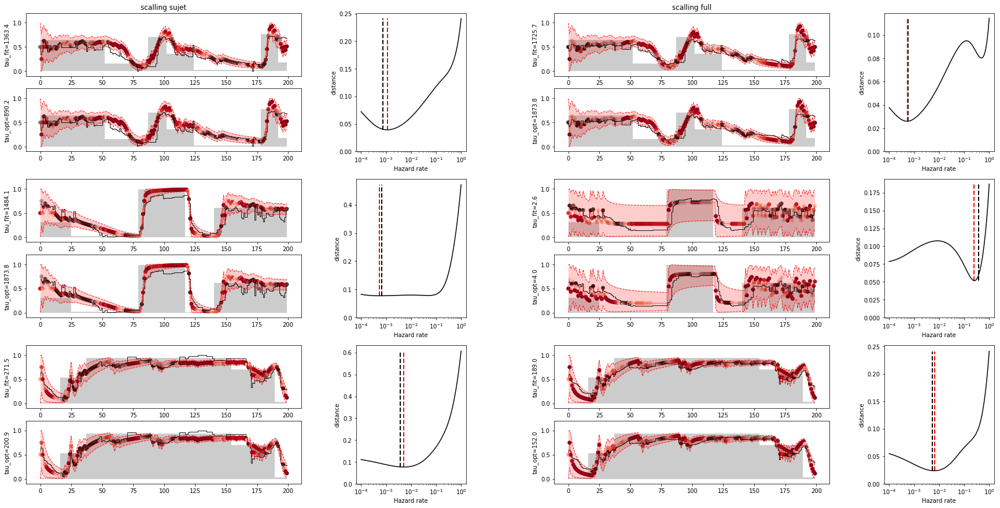

BMC

scalling sujet
block 0 --> tau_fit=38.5 , h_fit=0.02597 , tau_opt=34.3 , h_opt=0.02915
block 1 --> tau_fit=5.5 , h_fit=0.18302 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=84.9 , h_fit=0.01178 , tau_opt=37.6 , h_opt=0.02656

scalling full
block 0 --> tau_fit=38.8 , h_fit=0.02578 , tau_opt=37.6 , h_opt=0.02656
block 1 --> tau_fit=6.5 , h_fit=0.15270 , tau_opt=14.8 , h_opt=0.06734
block 2 --> tau_fit=96.1 , h_fit=0.01041 , tau_opt=31.3 , h_opt=0.03199


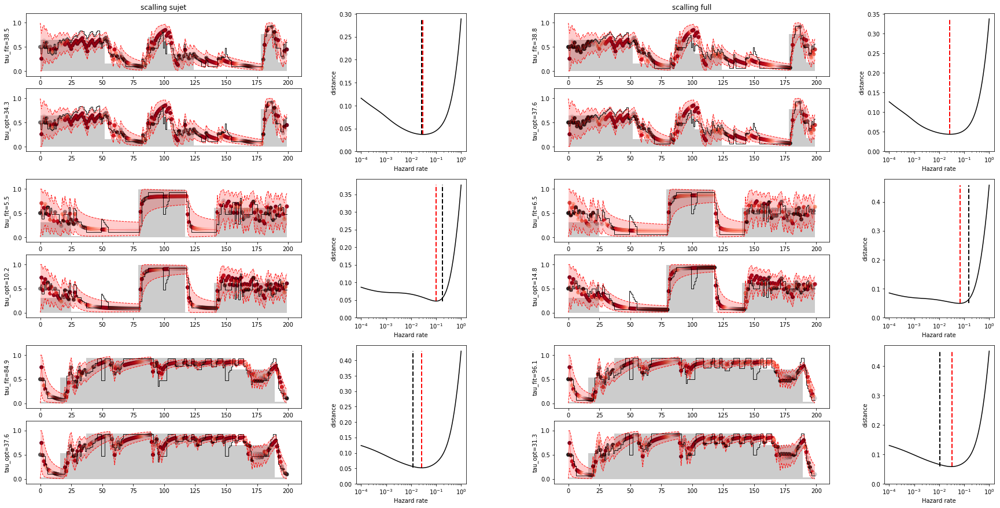

CS

scalling sujet
block 0 --> tau_fit=2.1 , h_fit=0.47048 , tau_opt=3.7 , h_opt=0.27186
block 1 --> tau_fit=5.5 , h_fit=0.18227 , tau_opt=11.2 , h_opt=0.08902
block 2 --> tau_fit=9.1 , h_fit=0.11028 , tau_opt=5.9 , h_opt=0.17074

scalling full
block 0 --> tau_fit=1.6 , h_fit=0.61874 , tau_opt=2.5 , h_opt=0.39442
block 1 --> tau_fit=4.2 , h_fit=0.23872 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=4.8 , h_fit=0.20948 , tau_opt=3.7 , h_opt=0.27186


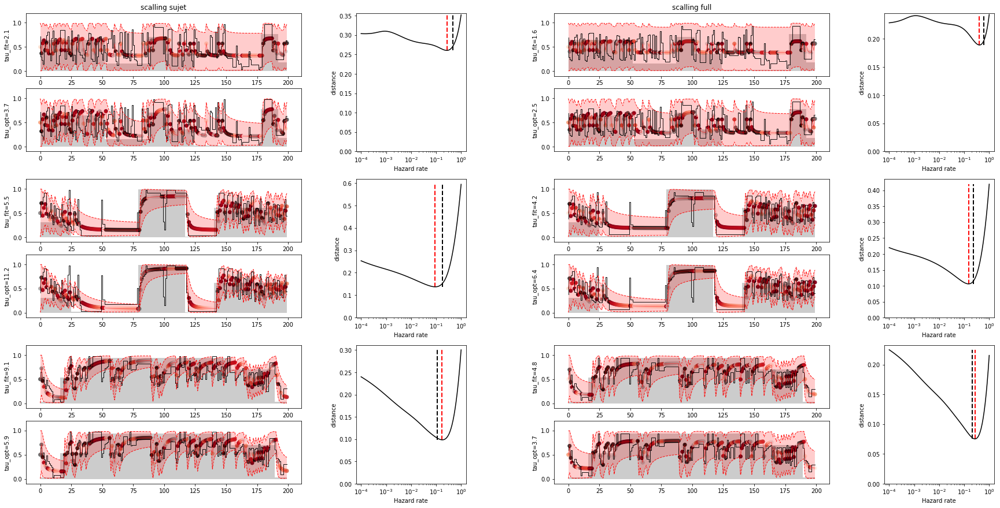

DC

scalling sujet
block 0 --> tau_fit=4.6 , h_fit=0.21928 , tau_opt=3.1 , h_opt=0.32745
block 1 --> tau_fit=7.7 , h_fit=0.12924 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=13.6 , h_fit=0.07337 , tau_opt=14.8 , h_opt=0.06734

scalling full
block 0 --> tau_fit=1.7 , h_fit=0.59518 , tau_opt=2.1 , h_opt=0.47508
block 1 --> tau_fit=2.3 , h_fit=0.43101 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=5.1 , h_fit=0.19772 , tau_opt=4.4 , h_opt=0.22570


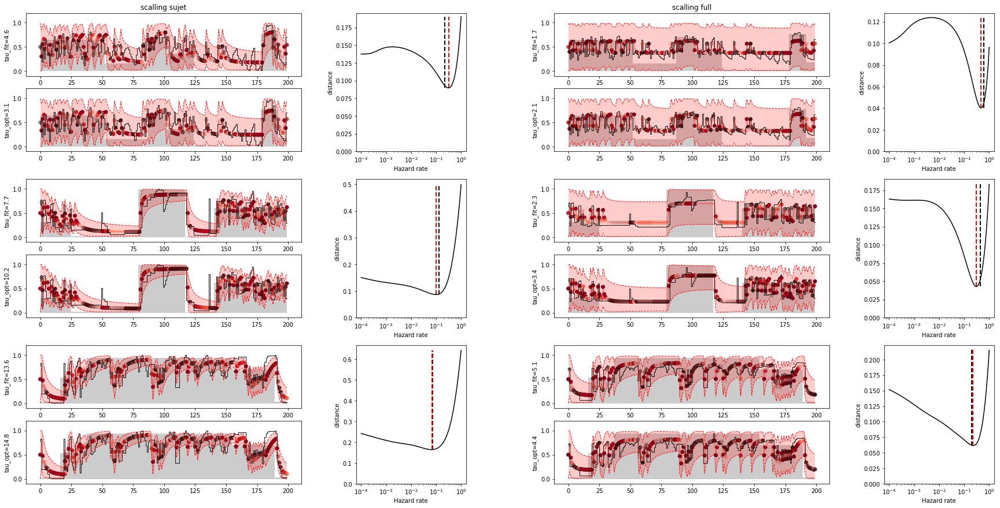

FM

scalling sujet
block 0 --> tau_fit=2.3 , h_fit=0.43575 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=4.2 , h_fit=0.23576 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=13.9 , h_fit=0.07203 , tau_opt=13.5 , h_opt=0.07391

scalling full
block 0 --> tau_fit=3.1 , h_fit=0.32405 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.6 , h_fit=0.18006 , tau_opt=12.3 , h_opt=0.08111
block 2 --> tau_fit=17.8 , h_fit=0.05633 , tau_opt=16.3 , h_opt=0.06136


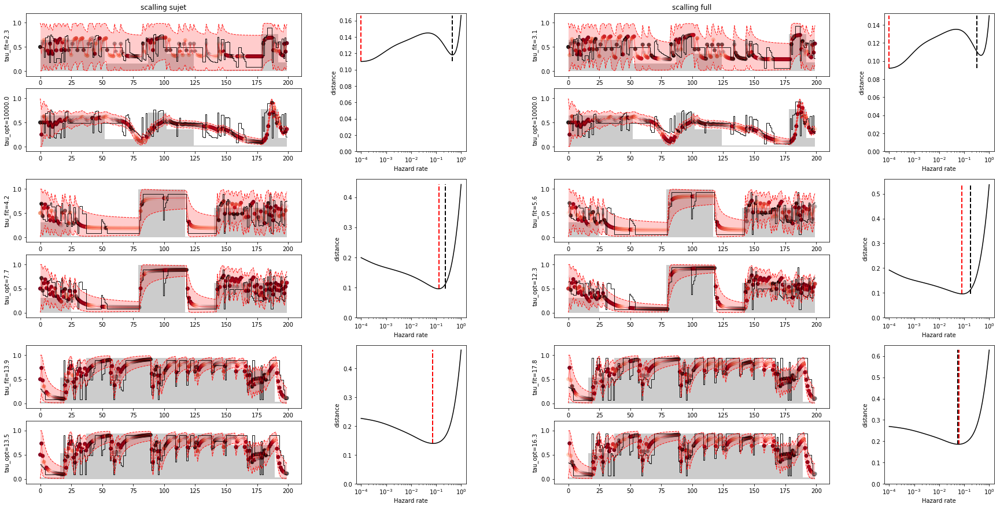

IP

scalling sujet
block 0 --> tau_fit=113.2 , h_fit=0.00883 , tau_opt=87.0 , h_opt=0.01150
block 1 --> tau_fit=12.6 , h_fit=0.07950 , tau_opt=34.3 , h_opt=0.02915
block 2 --> tau_fit=47.1 , h_fit=0.02123 , tau_opt=41.3 , h_opt=0.02420

scalling full
block 0 --> tau_fit=14754.2 , h_fit=0.00007 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=5.6 , h_fit=0.17857 , tau_opt=9.3 , h_opt=0.10723
block 2 --> tau_fit=39.8 , h_fit=0.02515 , tau_opt=3.1 , h_opt=0.32745


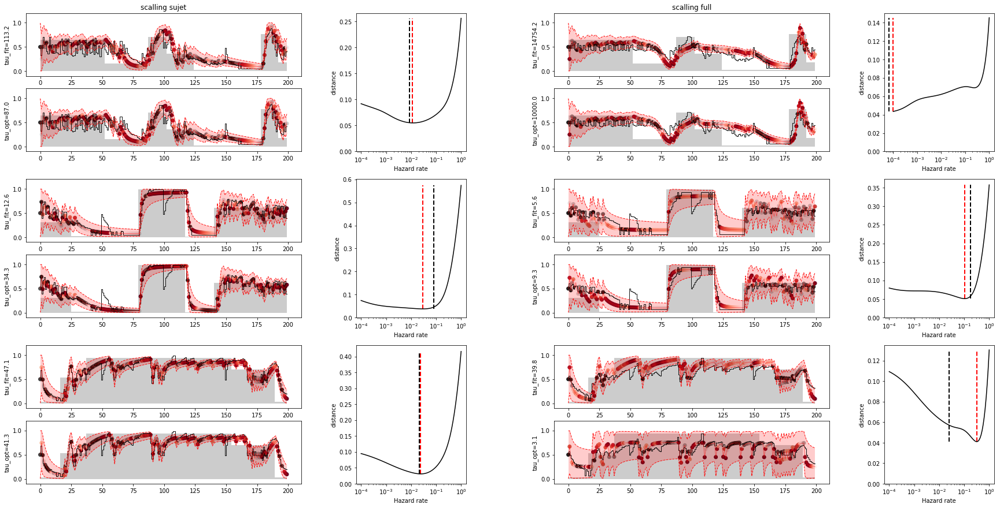

LB

scalling sujet
block 0 --> tau_fit=4.2 , h_fit=0.23708 , tau_opt=126.2 , h_opt=0.00792
block 1 --> tau_fit=9.1 , h_fit=0.11044 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=119.9 , h_fit=0.00834 , tau_opt=49.8 , h_opt=0.02009

scalling full
block 0 --> tau_fit=250.3 , h_fit=0.00399 , tau_opt=183.1 , h_opt=0.00546
block 1 --> tau_fit=3.6 , h_fit=0.27905 , tau_opt=4.4 , h_opt=0.22570
block 2 --> tau_fit=35.7 , h_fit=0.02803 , tau_opt=26.0 , h_opt=0.03854


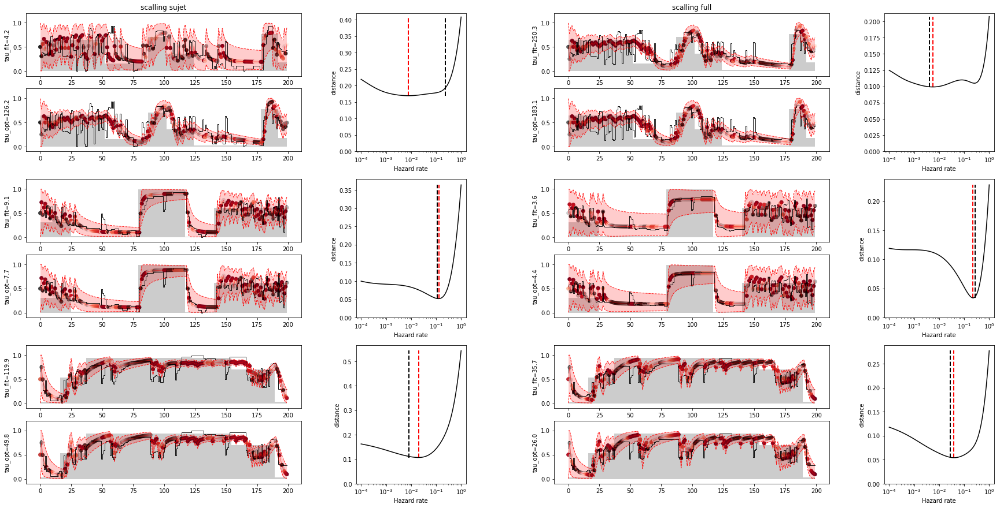

OP

scalling sujet
block 0 --> tau_fit=7023.7 , h_fit=0.00014 , tau_opt=10000.0 , h_opt=0.00010
block 1 --> tau_fit=50.1 , h_fit=0.01995 , tau_opt=9.3 , h_opt=0.10723
block 2 --> tau_fit=8.8 , h_fit=0.11374 , tau_opt=8.5 , h_opt=0.11768

scalling full
block 0 --> tau_fit=5988.9 , h_fit=0.00017 , tau_opt=6892.6 , h_opt=0.00015
block 1 --> tau_fit=103.3 , h_fit=0.00968 , tau_opt=37.6 , h_opt=0.02656
block 2 --> tau_fit=12.1 , h_fit=0.08278 , tau_opt=12.3 , h_opt=0.08111


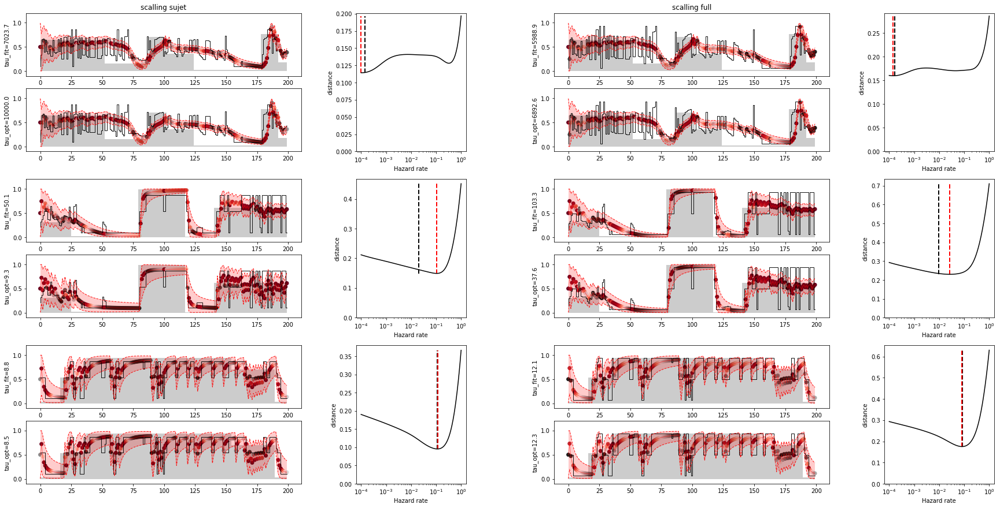

RS

scalling sujet
block 0 --> tau_fit=2.3 , h_fit=0.42929 , tau_opt=3.1 , h_opt=0.32745
block 1 --> tau_fit=2.6 , h_fit=0.38139 , tau_opt=3.1 , h_opt=0.32745
block 2 --> tau_fit=78.0 , h_fit=0.01283 , tau_opt=291.5 , h_opt=0.00343

scalling full
block 0 --> tau_fit=33631.4 , h_fit=0.00003 , tau_opt=2.3 , h_opt=0.43288
block 1 --> tau_fit=2.2 , h_fit=0.46295 , tau_opt=4.4 , h_opt=0.22570
block 2 --> tau_fit=1.7 , h_fit=0.58932 , tau_opt=183.1 , h_opt=0.00546


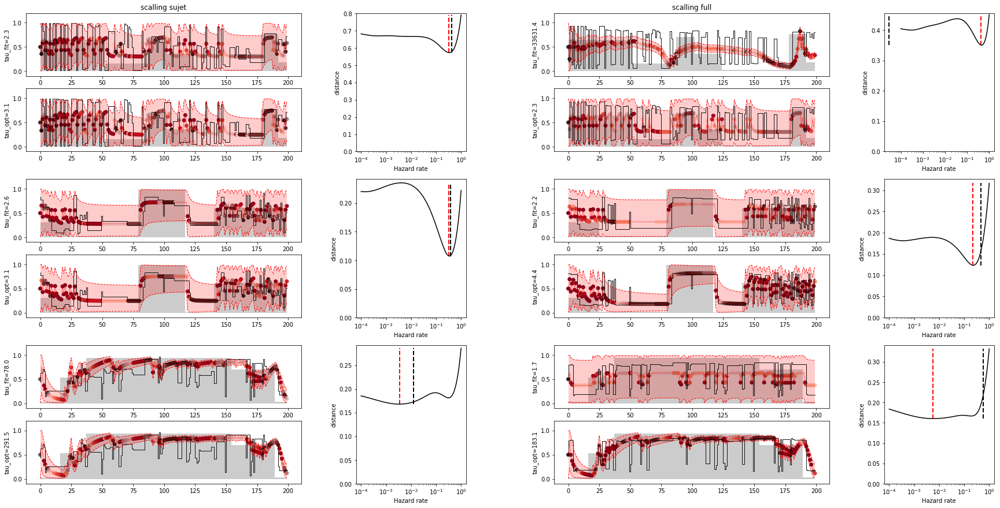

SR

scalling sujet
block 0 --> tau_fit=572.8 , h_fit=0.00175 , tau_opt=104.8 , h_opt=0.00955
block 1 --> tau_fit=3.8 , h_fit=0.26265 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=562.4 , h_fit=0.00178 , tau_opt=559.1 , h_opt=0.00179

scalling full
block 0 --> tau_fit=680.4 , h_fit=0.00147 , tau_opt=115.0 , h_opt=0.00870
block 1 --> tau_fit=3.7 , h_fit=0.27102 , tau_opt=5.3 , h_opt=0.18738
block 2 --> tau_fit=577.1 , h_fit=0.00173 , tau_opt=385.4 , h_opt=0.00260


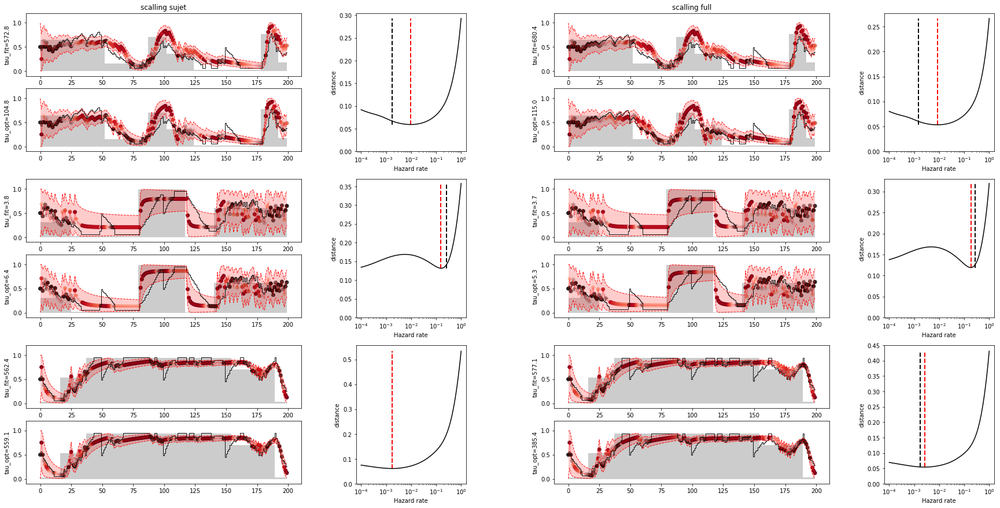

TN

scalling sujet
block 0 --> tau_fit=3.7 , h_fit=0.26674 , tau_opt=9111.6 , h_opt=0.00011
block 1 --> tau_fit=8.7 , h_fit=0.11522 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=31.6 , h_fit=0.03168 , tau_opt=34.3 , h_opt=0.02915

scalling full
block 0 --> tau_fit=18.0 , h_fit=0.05555 , tau_opt=34.3 , h_opt=0.02915
block 1 --> tau_fit=20.2 , h_fit=0.04950 , tau_opt=21.5 , h_opt=0.04642
block 2 --> tau_fit=44.2 , h_fit=0.02260 , tau_opt=41.3 , h_opt=0.02420


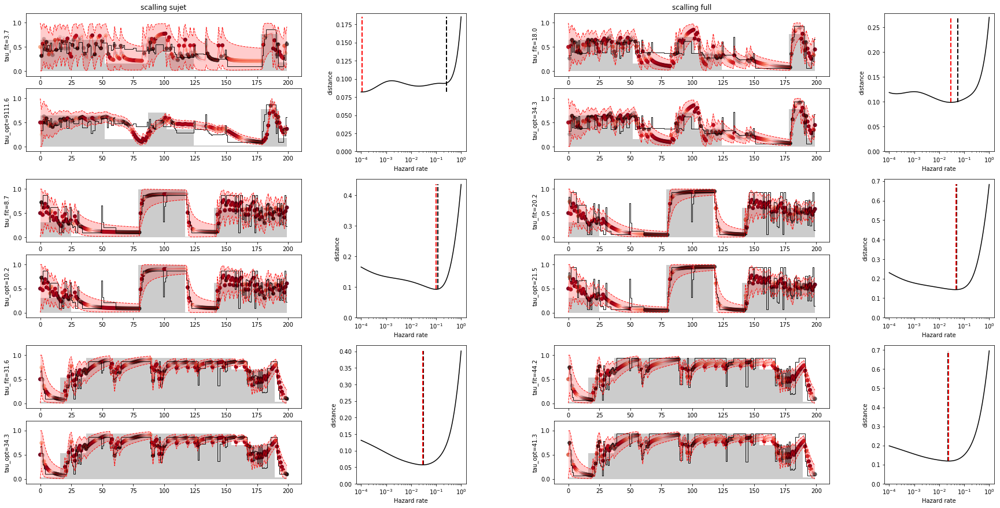

YK

scalling sujet
block 0 --> tau_fit=14768.9 , h_fit=0.00007 , tau_opt=1.9 , h_opt=0.52140
block 1 --> tau_fit=1.5 , h_fit=0.67910 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=4.9 , h_fit=0.20204 , tau_opt=4.4 , h_opt=0.22570

scalling full
block 0 --> tau_fit=178.6 , h_fit=0.00560 , tau_opt=95.5 , h_opt=0.01048
block 1 --> tau_fit=29.9 , h_fit=0.03347 , tau_opt=17.9 , h_opt=0.05591
block 2 --> tau_fit=14.0 , h_fit=0.07167 , tau_opt=23.6 , h_opt=0.04229


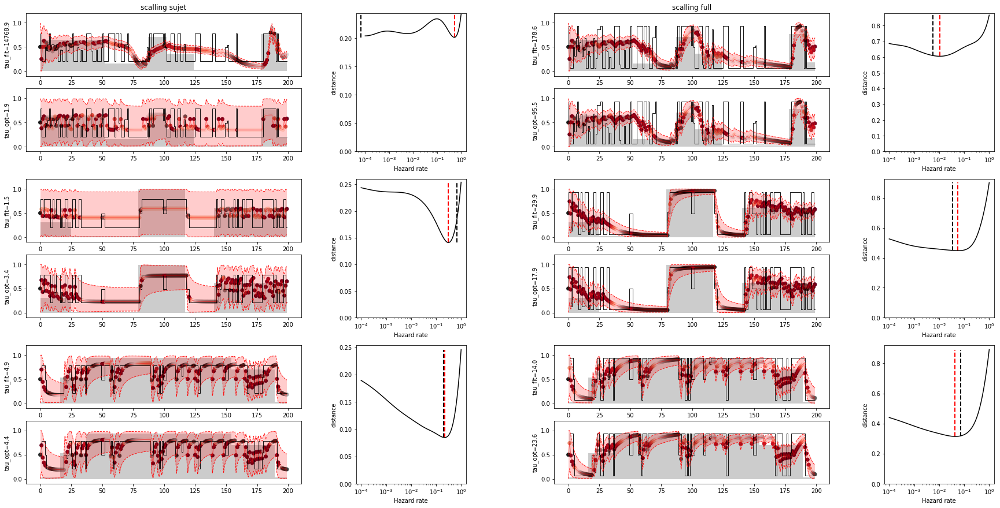

In [14]:
evaluating (new_bet_sujet, new_bet_full, h_bet_sujet, h_bet_full)

AM

scalling sujet
block 0
pause 0 --> tau_fit=1483.1 , h_fit=0.00067 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=2322.4 , h_fit=0.00043 , tau_opt=2983.6 , h_opt=0.00034
pause 2 --> tau_fit=367257572853.8 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=12455.5 , h_fit=0.00008 , tau_opt=10000.0 , h_opt=0.00010
block 1
pause 0 --> tau_fit=212.6 , h_fit=0.00470 , tau_opt=265.6 , h_opt=0.00376
pause 1 --> tau_fit=31313.3 , h_fit=0.00003 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=7764.5 , h_fit=0.00013 , tau_opt=6892.6 , h_opt=0.00015
pause 3 --> tau_fit=12.8 , h_fit=0.07798 , tau_opt=1.2 , h_opt=0.83022
block 2
pause 0 --> tau_fit=713.7 , h_fit=0.00140 , tau_opt=559.1 , h_opt=0.00179
pause 1 --> tau_fit=118.1 , h_fit=0.00846 , tau_opt=200.9 , h_opt=0.00498
pause 2 --> tau_fit=19043069473.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=107.7 , h_fit=0.00928 , tau_opt=104.8 , h_opt=0.00955

scalling full
block 0
pause 0 --> tau_f

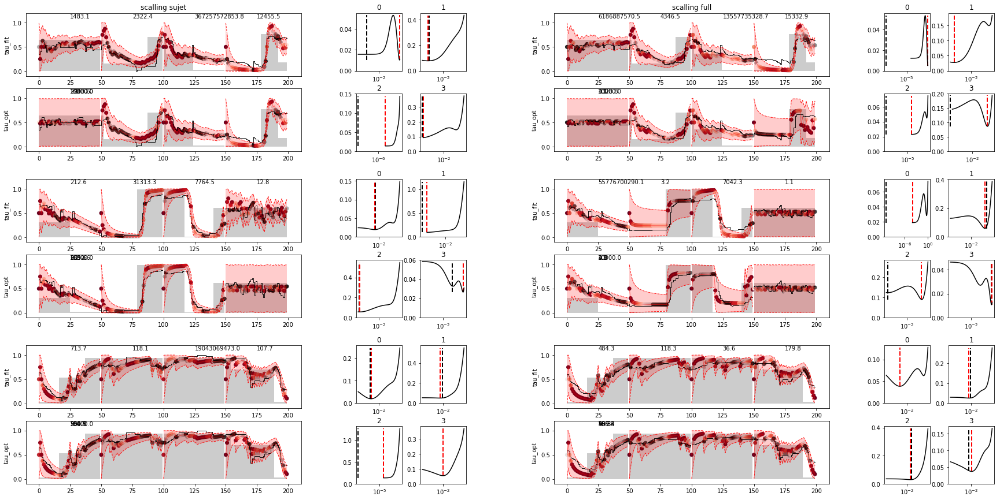

BMC

scalling sujet
block 0
pause 0 --> tau_fit=44.8 , h_fit=0.02232 , tau_opt=34.3 , h_opt=0.02915
pause 1 --> tau_fit=44.5 , h_fit=0.02245 , tau_opt=41.3 , h_opt=0.02420
pause 2 --> tau_fit=16.2 , h_fit=0.06168 , tau_opt=17.9 , h_opt=0.05591
pause 3 --> tau_fit=76.7 , h_fit=0.01304 , tau_opt=12.3 , h_opt=0.08111
block 1
pause 0 --> tau_fit=6.4 , h_fit=0.15510 , tau_opt=34.3 , h_opt=0.02915
pause 1 --> tau_fit=302.2 , h_fit=0.00331 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=31.5 , h_fit=0.03176 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=1.1 , h_fit=0.93374 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=33.6 , h_fit=0.02976 , tau_opt=28.5 , h_opt=0.03511
pause 1 --> tau_fit=116.7 , h_fit=0.00857 , tau_opt=65.8 , h_opt=0.01520
pause 2 --> tau_fit=20.6 , h_fit=0.04848 , tau_opt=28.5 , h_opt=0.03511
pause 3 --> tau_fit=22.0 , h_fit=0.04546 , tau_opt=26.0 , h_opt=0.03854

scalling full
block 0
pause 0 --> tau_fit=67.2 , h_fit=0.01488 , tau_opt=49.8 , h_opt=0.0200

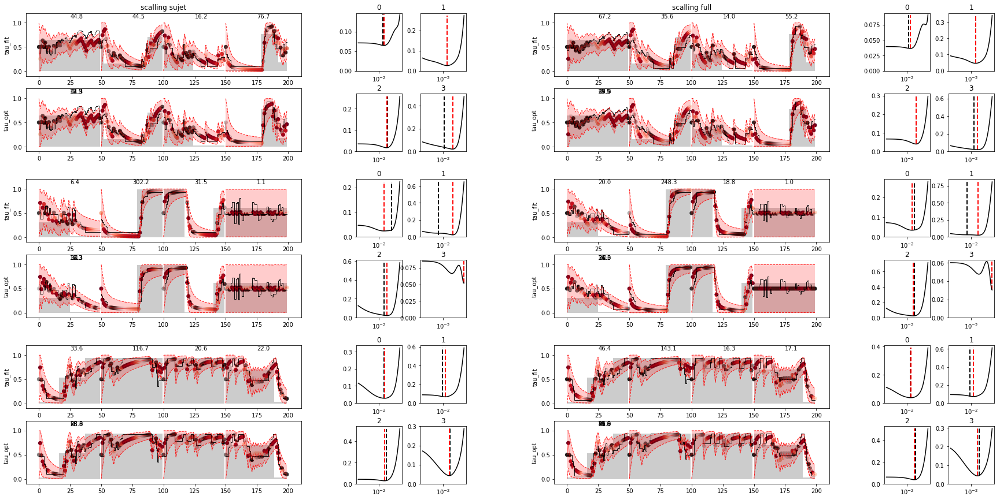

CS

scalling sujet
block 0
pause 0 --> tau_fit=72338283701.9 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=1.7 , h_fit=0.57144 , tau_opt=2.3 , h_opt=0.43288
pause 2 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.3 , h_opt=0.75646
pause 3 --> tau_fit=8.8 , h_fit=0.11421 , tau_opt=8.5 , h_opt=0.11768
block 1
pause 0 --> tau_fit=5.4 , h_fit=0.18632 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=5.7 , h_fit=0.17593 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=10.1 , h_fit=0.09950 , tau_opt=19.6 , h_opt=0.05094
pause 3 --> tau_fit=22.7 , h_fit=0.04407 , tau_opt=14.8 , h_opt=0.06734
block 2
pause 0 --> tau_fit=10.6 , h_fit=0.09430 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=6.1 , h_fit=0.16485 , tau_opt=4.4 , h_opt=0.22570
pause 2 --> tau_fit=9.0 , h_fit=0.11149 , tau_opt=3.4 , h_opt=0.29836
pause 3 --> tau_fit=10.3 , h_fit=0.09685 , tau_opt=3.7 , h_opt=0.27186

scalling full
block 0
pause 0 --> tau_fit=50893203869.0 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00

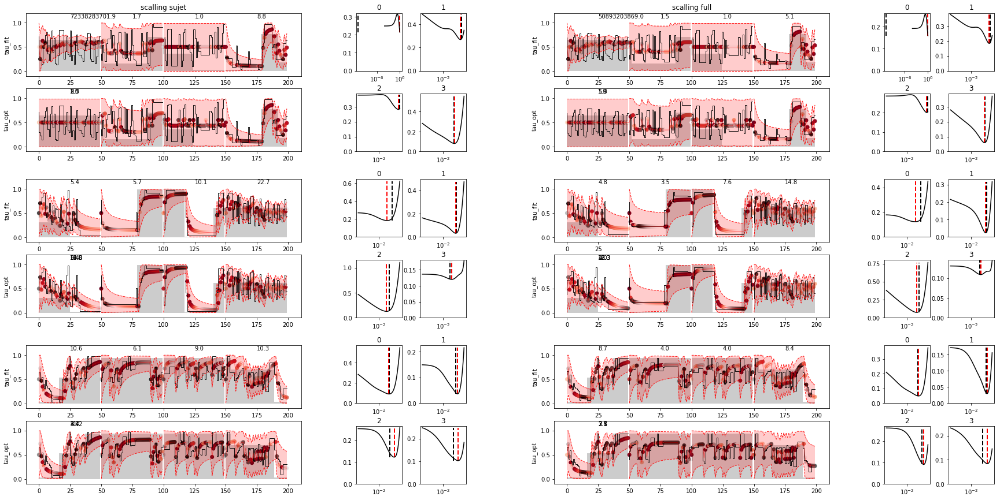

DC

scalling sujet
block 0
pause 0 --> tau_fit=1949.0 , h_fit=0.00051 , tau_opt=1.5 , h_opt=0.68926
pause 1 --> tau_fit=2.0 , h_fit=0.51000 , tau_opt=1.9 , h_opt=0.52140
pause 2 --> tau_fit=2644950884.8 , h_fit=0.00000 , tau_opt=1.9 , h_opt=0.52140
pause 3 --> tau_fit=6.9 , h_fit=0.14529 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=12.4 , h_fit=0.08077 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=1735.1 , h_fit=0.00058 , tau_opt=977.0 , h_opt=0.00102
pause 2 --> tau_fit=4.9 , h_fit=0.20496 , tau_opt=11.2 , h_opt=0.08902
pause 3 --> tau_fit=10.0 , h_fit=0.10039 , tau_opt=5.3 , h_opt=0.18738
block 2
pause 0 --> tau_fit=13.7 , h_fit=0.07324 , tau_opt=26.0 , h_opt=0.03854
pause 1 --> tau_fit=31.9 , h_fit=0.03133 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=21.6 , h_fit=0.04622 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=12.2 , h_fit=0.08178 , tau_opt=17.9 , h_opt=0.05591

scalling full
block 0
pause 0 --> tau_fit=6229667645.8 , h_fit=0.00000 , tau_opt=1.5 , h_

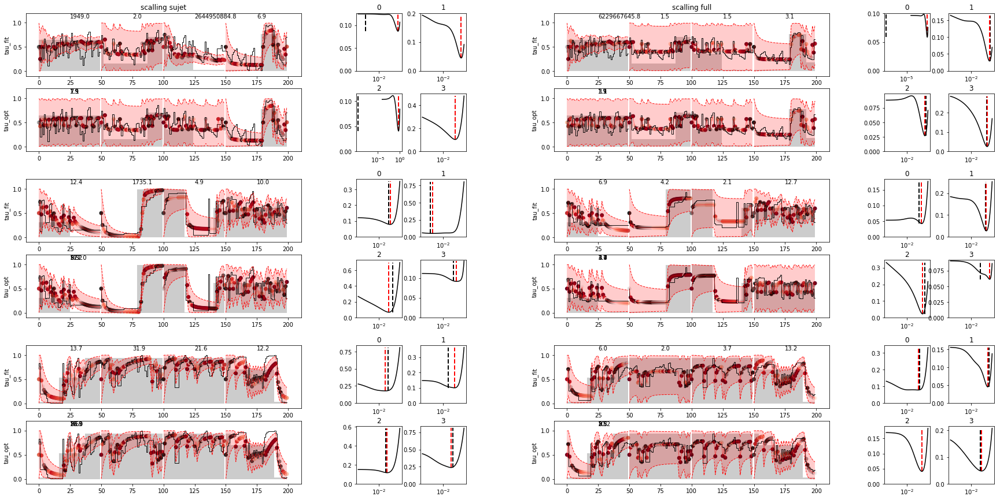

FM

scalling sujet
block 0
pause 0 --> tau_fit=1892547841.2 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=276.7 , h_fit=0.00361 , tau_opt=1.6 , h_opt=0.62803
pause 2 --> tau_fit=2.1 , h_fit=0.48370 , tau_opt=1.9 , h_opt=0.52140
pause 3 --> tau_fit=3.7 , h_fit=0.26670 , tau_opt=5.9 , h_opt=0.17074
block 1
pause 0 --> tau_fit=273.0 , h_fit=0.00366 , tau_opt=104.8 , h_opt=0.00955
pause 1 --> tau_fit=14.2 , h_fit=0.07027 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=4.9 , h_fit=0.20214 , tau_opt=9.3 , h_opt=0.10723
pause 3 --> tau_fit=1.7 , h_fit=0.59245 , tau_opt=1.7 , h_opt=0.57224
block 2
pause 0 --> tau_fit=3.3 , h_fit=0.30583 , tau_opt=6.4 , h_opt=0.15557
pause 1 --> tau_fit=4.2 , h_fit=0.23989 , tau_opt=7.1 , h_opt=0.14175
pause 2 --> tau_fit=12.2 , h_fit=0.08210 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=79.1 , h_fit=0.01264 , tau_opt=166.8 , h_opt=0.00599

scalling full
block 0
pause 0 --> tau_fit=7817011540.6 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1

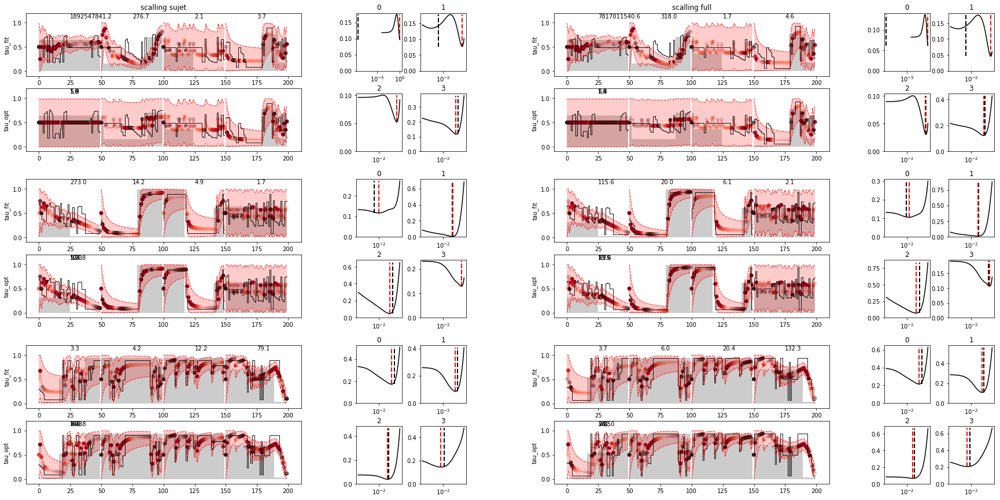

IP

scalling sujet
block 0
pause 0 --> tau_fit=107409650099.8 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=175.1 , h_fit=0.00571 , tau_opt=2.5 , h_opt=0.39442
pause 2 --> tau_fit=45.0 , h_fit=0.02220 , tau_opt=34.3 , h_opt=0.02915
pause 3 --> tau_fit=167.7 , h_fit=0.00596 , tau_opt=17.9 , h_opt=0.05591
block 1
pause 0 --> tau_fit=44.0 , h_fit=0.02272 , tau_opt=41.3 , h_opt=0.02420
pause 1 --> tau_fit=44.1 , h_fit=0.02269 , tau_opt=65.8 , h_opt=0.01520
pause 2 --> tau_fit=46.5 , h_fit=0.02150 , tau_opt=45.3 , h_opt=0.02205
pause 3 --> tau_fit=42.6 , h_fit=0.02347 , tau_opt=34.3 , h_opt=0.02915
block 2
pause 0 --> tau_fit=17.6 , h_fit=0.05695 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=36.9 , h_fit=0.02711 , tau_opt=34.3 , h_opt=0.02915
pause 2 --> tau_fit=470.0 , h_fit=0.00213 , tau_opt=242.0 , h_opt=0.00413
pause 3 --> tau_fit=67.7 , h_fit=0.01476 , tau_opt=59.9 , h_opt=0.01668

scalling full
block 0
pause 0 --> tau_fit=13673228208.5 , h_fit=0.00000 , tau_op

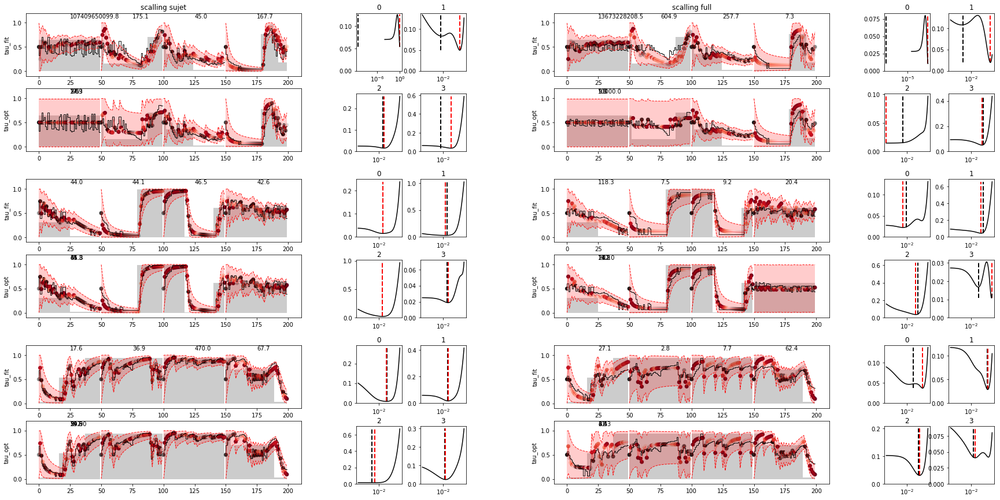

LB

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.37489 , tau_opt=2.1 , h_opt=0.47508
pause 1 --> tau_fit=348.1 , h_fit=0.00287 , tau_opt=87.0 , h_opt=0.01150
pause 2 --> tau_fit=39.4 , h_fit=0.02537 , tau_opt=37.6 , h_opt=0.02656
pause 3 --> tau_fit=164.3 , h_fit=0.00609 , tau_opt=79.2 , h_opt=0.01262
block 1
pause 0 --> tau_fit=6.7 , h_fit=0.14900 , tau_opt=4.4 , h_opt=0.22570
pause 1 --> tau_fit=10.0 , h_fit=0.10004 , tau_opt=7.7 , h_opt=0.12915
pause 2 --> tau_fit=16.2 , h_fit=0.06154 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=18.3 , h_fit=0.05456 , tau_opt=1.3 , h_opt=0.75646
block 2
pause 0 --> tau_fit=25.9 , h_fit=0.03861 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=5.2 , h_fit=0.19103 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=22159151579.9 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=88.6 , h_fit=0.01128 , tau_opt=59.9 , h_opt=0.01668

scalling full
block 0
pause 0 --> tau_fit=19.4 , h_fit=0.05151 , tau_opt=1.3 , h_opt=0

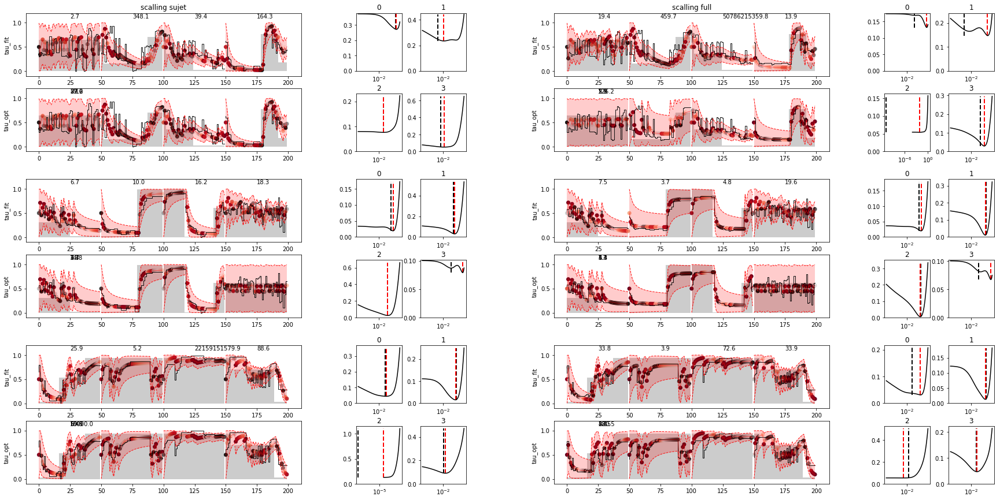

OP

scalling sujet
block 0
pause 0 --> tau_fit=30941237278.3 , h_fit=0.00000 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=1006.7 , h_fit=0.00099 , tau_opt=1.7 , h_opt=0.57224
pause 2 --> tau_fit=1.3 , h_fit=0.74408 , tau_opt=1.6 , h_opt=0.62803
pause 3 --> tau_fit=6.7 , h_fit=0.14837 , tau_opt=8.5 , h_opt=0.11768
block 1
pause 0 --> tau_fit=4.8 , h_fit=0.20688 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=5.6 , h_fit=0.17952 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=6.6 , h_fit=0.15116 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=3624128987.3 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
block 2
pause 0 --> tau_fit=20.8 , h_fit=0.04808 , tau_opt=12.3 , h_opt=0.08111
pause 1 --> tau_fit=4.9 , h_fit=0.20500 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=5.7 , h_fit=0.17530 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=32.5 , h_fit=0.03077 , tau_opt=23.6 , h_opt=0.04229

scalling full
block 0
pause 0 --> tau_fit=2159676039.8 , h_fit=0.00000 , tau_opt=1.1 ,

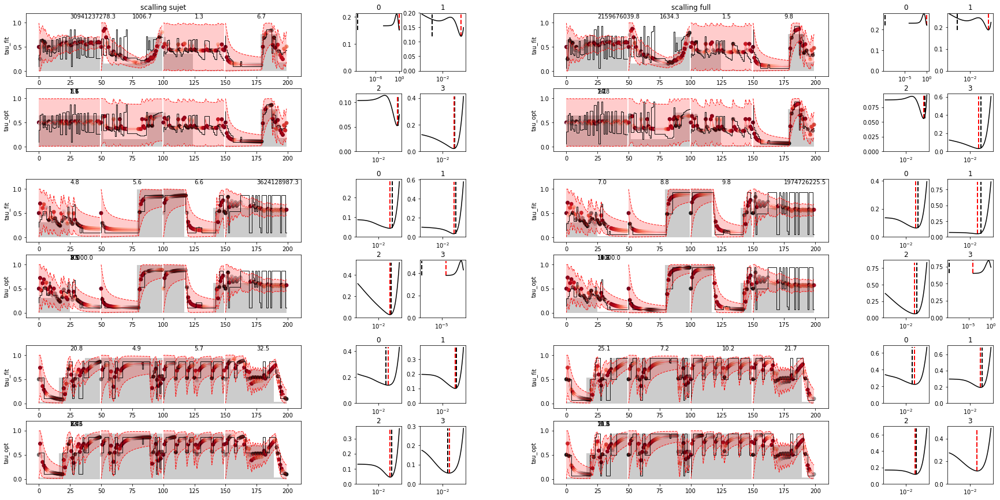

RS

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.37241 , tau_opt=3.1 , h_opt=0.32745
pause 1 --> tau_fit=1.6 , h_fit=0.60788 , tau_opt=1.7 , h_opt=0.57224
pause 2 --> tau_fit=5.9 , h_fit=0.17005 , tau_opt=16.3 , h_opt=0.06136
pause 3 --> tau_fit=2.3 , h_fit=0.44250 , tau_opt=2.8 , h_opt=0.35938
block 1
pause 0 --> tau_fit=7.1 , h_fit=0.14115 , tau_opt=8.5 , h_opt=0.11768
pause 1 --> tau_fit=2.1 , h_fit=0.46650 , tau_opt=2.8 , h_opt=0.35938
pause 2 --> tau_fit=3.1 , h_fit=0.32398 , tau_opt=2.8 , h_opt=0.35938
pause 3 --> tau_fit=353.6 , h_fit=0.00283 , tau_opt=1.5 , h_opt=0.68926
block 2
pause 0 --> tau_fit=642.3 , h_fit=0.00156 , tau_opt=1.7 , h_opt=0.57224
pause 1 --> tau_fit=199.9 , h_fit=0.00500 , tau_opt=265.6 , h_opt=0.00376
pause 2 --> tau_fit=3.3 , h_fit=0.29894 , tau_opt=3.7 , h_opt=0.27186
pause 3 --> tau_fit=51.8 , h_fit=0.01932 , tau_opt=115.0 , h_opt=0.00870

scalling full
block 0
pause 0 --> tau_fit=2.4 , h_fit=0.41111 , tau_opt=3.1 , h_opt=0.32745
pause 1 --> 

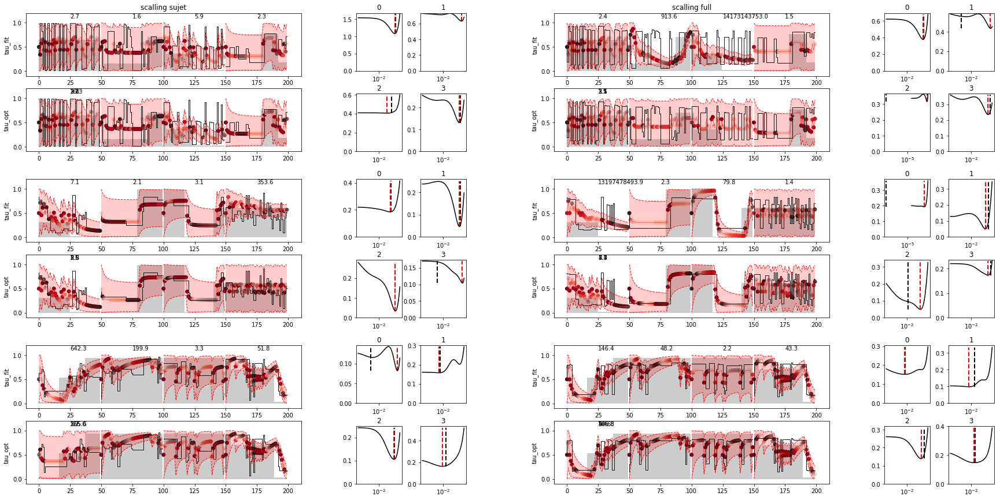

SR

scalling sujet
block 0
pause 0 --> tau_fit=43.6 , h_fit=0.02296 , tau_opt=41.3 , h_opt=0.02420
pause 1 --> tau_fit=4907.5 , h_fit=0.00020 , tau_opt=10000.0 , h_opt=0.00010
pause 2 --> tau_fit=21.1 , h_fit=0.04731 , tau_opt=31.3 , h_opt=0.03199
pause 3 --> tau_fit=5.5 , h_fit=0.18323 , tau_opt=10.2 , h_opt=0.09770
block 1
pause 0 --> tau_fit=12.5 , h_fit=0.07985 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=3.7 , h_fit=0.26980 , tau_opt=5.9 , h_opt=0.17074
pause 2 --> tau_fit=3.2 , h_fit=0.31293 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=40.0 , h_fit=0.02498 , tau_opt=49.8 , h_opt=0.02009
block 2
pause 0 --> tau_fit=789.3 , h_fit=0.00127 , tau_opt=1417.5 , h_opt=0.00071
pause 1 --> tau_fit=171.0 , h_fit=0.00585 , tau_opt=385.4 , h_opt=0.00260
pause 2 --> tau_fit=6211635409.6 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=240.0 , h_fit=0.00417 , tau_opt=422.9 , h_opt=0.00236

scalling full
block 0
pause 0 --> tau_fit=65.8 , h_fit=0.01519 , tau_o

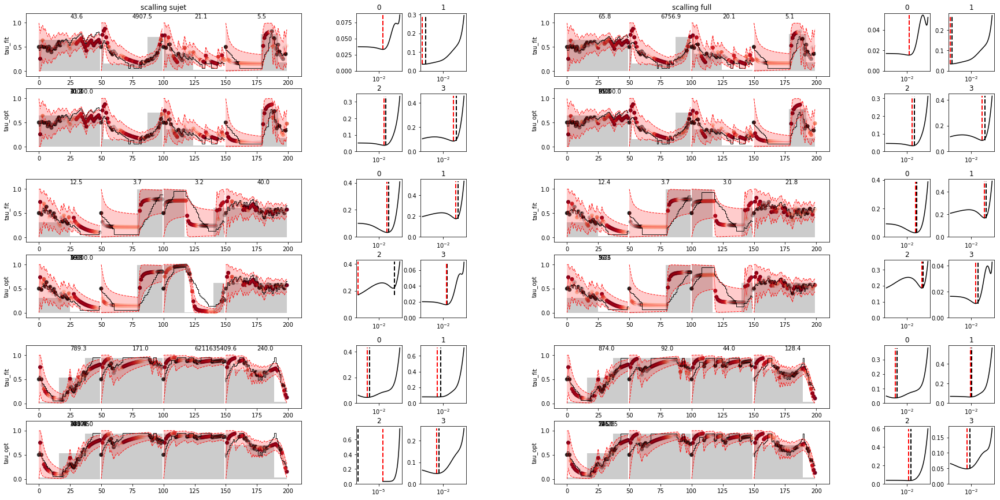

TN

scalling sujet
block 0
pause 0 --> tau_fit=46089042622.6 , h_fit=0.00000 , tau_opt=1.1 , h_opt=0.91116
pause 1 --> tau_fit=8284.1 , h_fit=0.00012 , tau_opt=1.1 , h_opt=0.91116
pause 2 --> tau_fit=14.3 , h_fit=0.07016 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=13.6 , h_fit=0.07331 , tau_opt=13.5 , h_opt=0.07391
block 1
pause 0 --> tau_fit=23.9 , h_fit=0.04178 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=7.2 , h_fit=0.13819 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=27.1 , h_fit=0.03696 , tau_opt=13.5 , h_opt=0.07391
pause 3 --> tau_fit=16.2 , h_fit=0.06178 , tau_opt=28.5 , h_opt=0.03511
block 2
pause 0 --> tau_fit=191.5 , h_fit=0.00522 , tau_opt=200.9 , h_opt=0.00498
pause 1 --> tau_fit=36.1 , h_fit=0.02769 , tau_opt=19.6 , h_opt=0.05094
pause 2 --> tau_fit=21.2 , h_fit=0.04712 , tau_opt=54.6 , h_opt=0.01831
pause 3 --> tau_fit=24.0 , h_fit=0.04163 , tau_opt=21.5 , h_opt=0.04642

scalling full
block 0
pause 0 --> tau_fit=3282238612.0 , h_fit=0.00000 , tau_opt

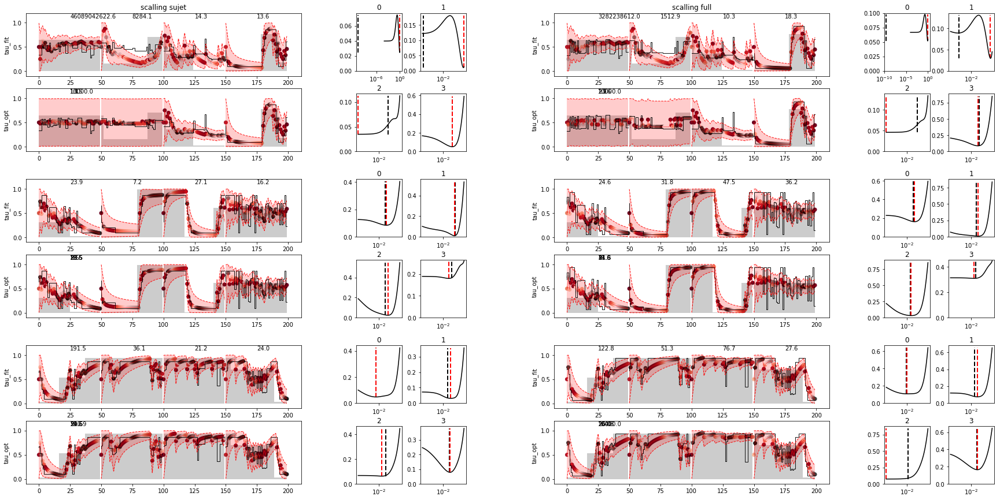

YK

scalling sujet
block 0
pause 0 --> tau_fit=5636195393.2 , h_fit=0.00000 , tau_opt=1.0 , h_opt=1.00000
pause 1 --> tau_fit=148.7 , h_fit=0.00673 , tau_opt=1.9 , h_opt=0.52140
pause 2 --> tau_fit=413439014.0 , h_fit=0.00000 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=2.1 , h_fit=0.48481 , tau_opt=4.0 , h_opt=0.24771
block 1
pause 0 --> tau_fit=17050134249092.5 , h_fit=0.00000 , tau_opt=3274.5 , h_opt=0.00031
pause 1 --> tau_fit=3.0 , h_fit=0.33712 , tau_opt=3.7 , h_opt=0.27186
pause 2 --> tau_fit=3.0 , h_fit=0.32945 , tau_opt=3.7 , h_opt=0.27186
pause 3 --> tau_fit=15.5 , h_fit=0.06444 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=1.9 , h_fit=0.51363 , tau_opt=3.7 , h_opt=0.27186
pause 1 --> tau_fit=2.7 , h_fit=0.36821 , tau_opt=3.7 , h_opt=0.27186
pause 2 --> tau_fit=5.8 , h_fit=0.17375 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=22.7 , h_fit=0.04415 , tau_opt=12.3 , h_opt=0.08111

scalling full
block 0
pause 0 --> tau_fit=169488221763.1 , h_fit=0.00000 ,

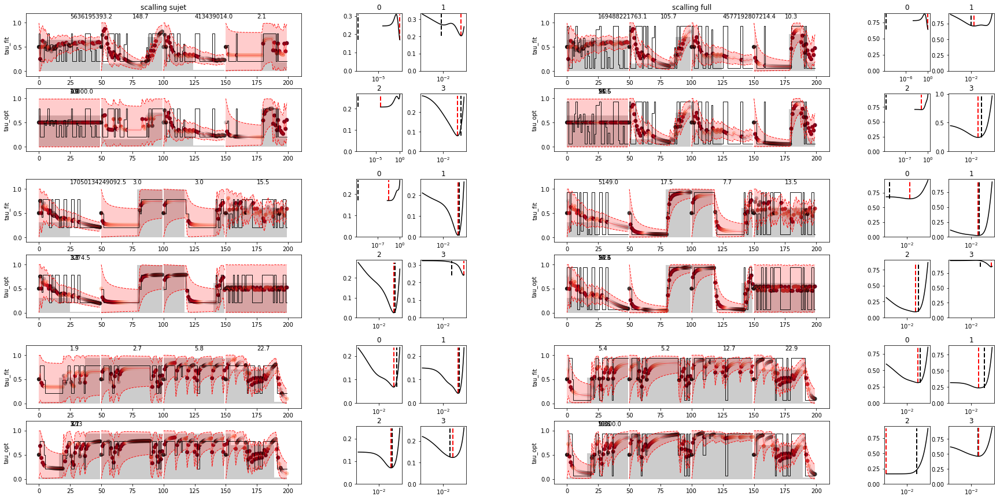

In [15]:
evaluating (new_bet_sujet, new_bet_full, h_bet_sujet, h_bet_full, show='h_pause')

### VA

AM

scalling sujet
block 0 --> tau_fit=6.0 , h_fit=0.16551 , tau_opt=4.9 , h_opt=0.20565
block 1 --> tau_fit=7.9 , h_fit=0.12659 , tau_opt=8.5 , h_opt=0.11768
block 2 --> tau_fit=1405.3 , h_fit=0.00071 , tau_opt=138.5 , h_opt=0.00722

scalling full
block 0 --> tau_fit=1.4 , h_fit=0.70528 , tau_opt=1.7 , h_opt=0.57224
block 1 --> tau_fit=3.2 , h_fit=0.30921 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=416.8 , h_fit=0.00240 , tau_opt=265.6 , h_opt=0.00376


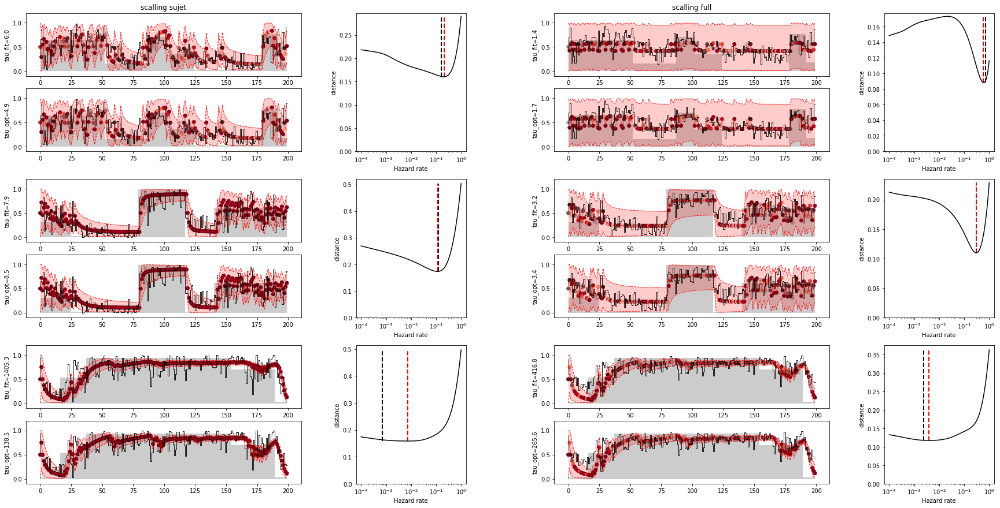

BMC

scalling sujet
block 0 --> tau_fit=3.0 , h_fit=0.33079 , tau_opt=4.9 , h_opt=0.20565
block 1 --> tau_fit=11.1 , h_fit=0.09009 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=15.5 , h_fit=0.06438 , tau_opt=16.3 , h_opt=0.06136

scalling full
block 0 --> tau_fit=2.3 , h_fit=0.43554 , tau_opt=3.4 , h_opt=0.29836
block 1 --> tau_fit=8.6 , h_fit=0.11615 , tau_opt=7.1 , h_opt=0.14175
block 2 --> tau_fit=14.2 , h_fit=0.07043 , tau_opt=14.8 , h_opt=0.06734


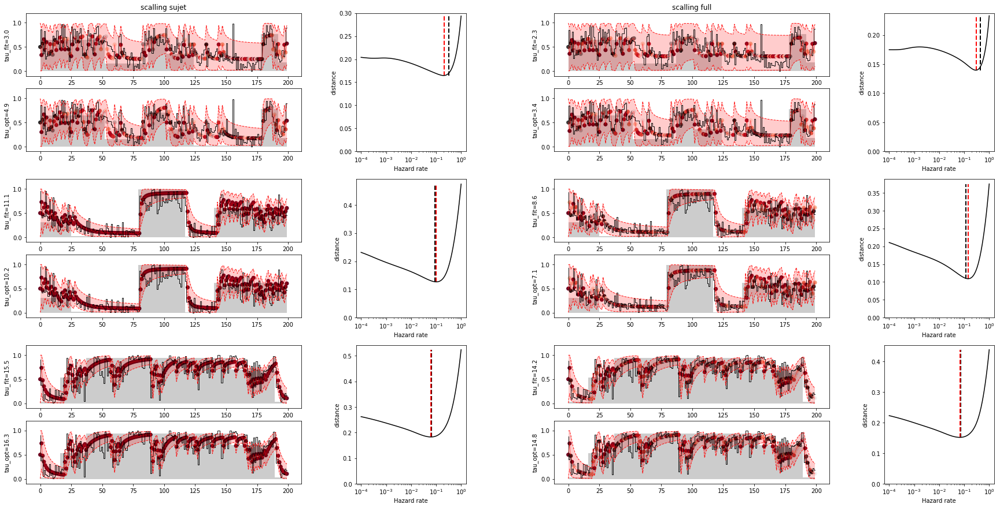

CS

scalling sujet
block 0 --> tau_fit=8.7 , h_fit=0.11550 , tau_opt=9.3 , h_opt=0.10723
block 1 --> tau_fit=9.6 , h_fit=0.10408 , tau_opt=8.5 , h_opt=0.11768
block 2 --> tau_fit=70.7 , h_fit=0.01415 , tau_opt=41.3 , h_opt=0.02420

scalling full
block 0 --> tau_fit=3.7 , h_fit=0.26909 , tau_opt=4.4 , h_opt=0.22570
block 1 --> tau_fit=4.6 , h_fit=0.21765 , tau_opt=4.0 , h_opt=0.24771
block 2 --> tau_fit=44.2 , h_fit=0.02261 , tau_opt=28.5 , h_opt=0.03511


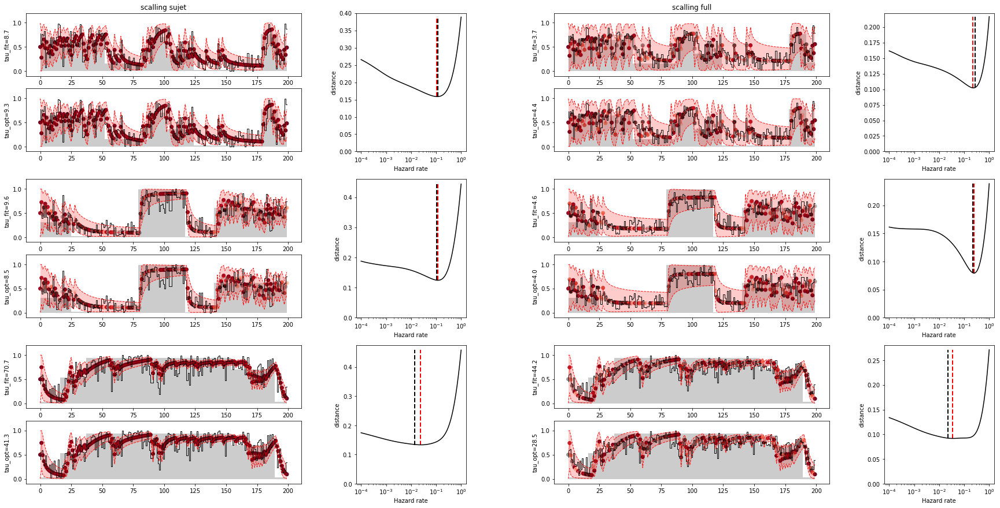

DC

scalling sujet
block 0 --> tau_fit=9.2 , h_fit=0.10917 , tau_opt=11.2 , h_opt=0.08902
block 1 --> tau_fit=7.0 , h_fit=0.14325 , tau_opt=7.1 , h_opt=0.14175
block 2 --> tau_fit=7.2 , h_fit=0.13926 , tau_opt=9.3 , h_opt=0.10723

scalling full
block 0 --> tau_fit=6.2 , h_fit=0.16171 , tau_opt=7.7 , h_opt=0.12915
block 1 --> tau_fit=5.3 , h_fit=0.18928 , tau_opt=5.9 , h_opt=0.17074
block 2 --> tau_fit=7.7 , h_fit=0.12905 , tau_opt=11.2 , h_opt=0.08902


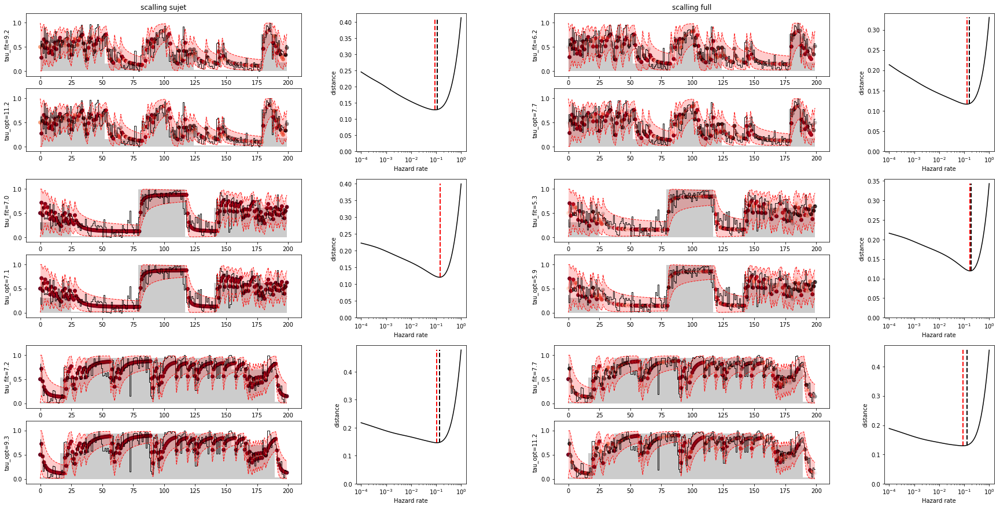

FM

scalling sujet
block 0 --> tau_fit=18.4 , h_fit=0.05444 , tau_opt=7.1 , h_opt=0.14175
block 1 --> tau_fit=4.3 , h_fit=0.23152 , tau_opt=12.3 , h_opt=0.08111
block 2 --> tau_fit=46.3 , h_fit=0.02161 , tau_opt=12.3 , h_opt=0.08111

scalling full
block 0 --> tau_fit=9.1 , h_fit=0.10951 , tau_opt=5.3 , h_opt=0.18738
block 1 --> tau_fit=3.7 , h_fit=0.27388 , tau_opt=12.3 , h_opt=0.08111
block 2 --> tau_fit=546.8 , h_fit=0.00183 , tau_opt=17.9 , h_opt=0.05591


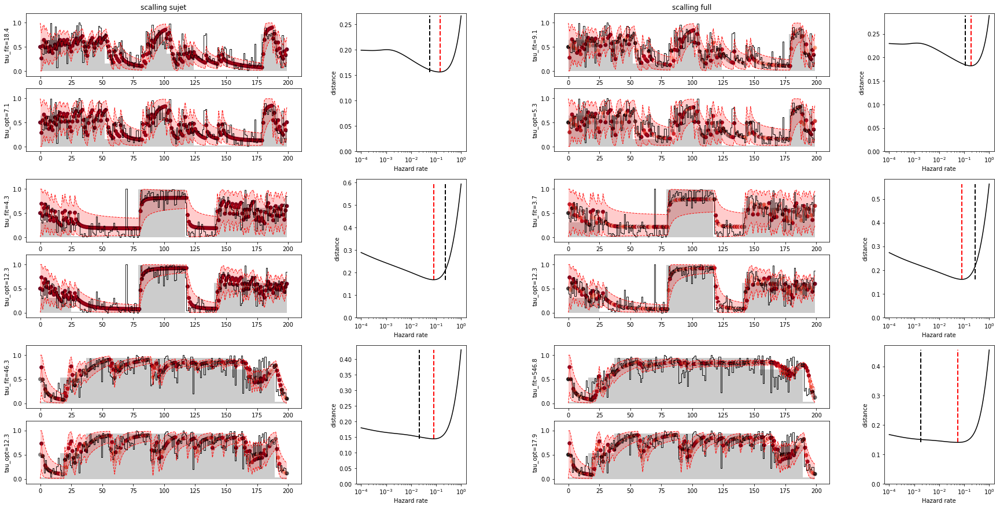

IP

scalling sujet
block 0 --> tau_fit=7.2 , h_fit=0.13916 , tau_opt=8.5 , h_opt=0.11768
block 1 --> tau_fit=7.5 , h_fit=0.13386 , tau_opt=7.1 , h_opt=0.14175
block 2 --> tau_fit=19.9 , h_fit=0.05033 , tau_opt=49.8 , h_opt=0.02009

scalling full
block 0 --> tau_fit=5.0 , h_fit=0.20150 , tau_opt=5.3 , h_opt=0.18738
block 1 --> tau_fit=6.2 , h_fit=0.16052 , tau_opt=5.9 , h_opt=0.17074
block 2 --> tau_fit=182.9 , h_fit=0.00547 , tau_opt=265.6 , h_opt=0.00376


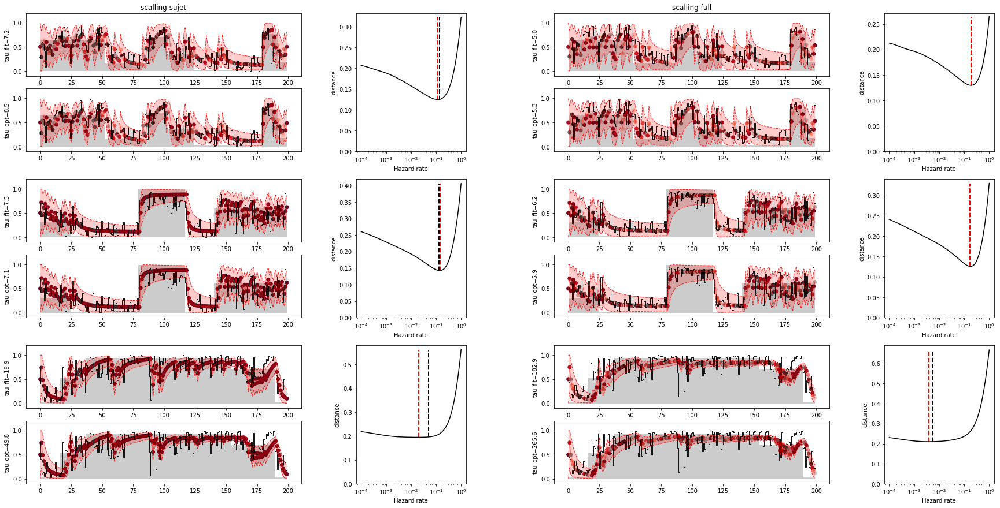

LB

scalling sujet
block 0 --> tau_fit=21.4 , h_fit=0.04676 , tau_opt=21.5 , h_opt=0.04642
block 1 --> tau_fit=6.2 , h_fit=0.16258 , tau_opt=6.4 , h_opt=0.15557
block 2 --> tau_fit=21.3 , h_fit=0.04691 , tau_opt=13.5 , h_opt=0.07391

scalling full
block 0 --> tau_fit=25.0 , h_fit=0.04004 , tau_opt=23.6 , h_opt=0.04229
block 1 --> tau_fit=8.5 , h_fit=0.11832 , tau_opt=14.8 , h_opt=0.06734
block 2 --> tau_fit=20.1 , h_fit=0.04973 , tau_opt=19.6 , h_opt=0.05094


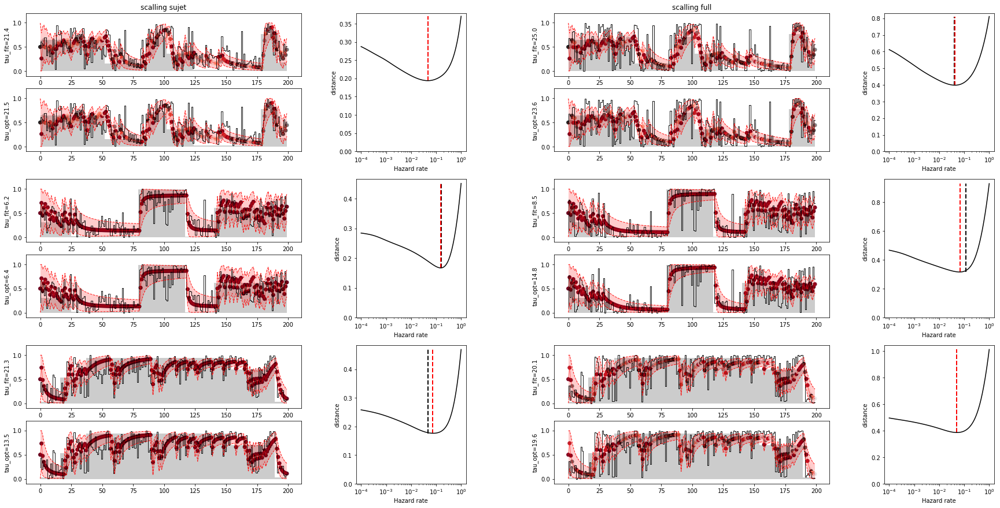

OP

scalling sujet
block 0 --> tau_fit=4.4 , h_fit=0.22591 , tau_opt=5.9 , h_opt=0.17074
block 1 --> tau_fit=2.4 , h_fit=0.42363 , tau_opt=3.4 , h_opt=0.29836
block 2 --> tau_fit=3.5 , h_fit=0.28281 , tau_opt=8.5 , h_opt=0.11768

scalling full
block 0 --> tau_fit=3.4 , h_fit=0.29189 , tau_opt=5.3 , h_opt=0.18738
block 1 --> tau_fit=2.2 , h_fit=0.46277 , tau_opt=2.8 , h_opt=0.35938
block 2 --> tau_fit=1.7 , h_fit=0.59724 , tau_opt=1.9 , h_opt=0.52140


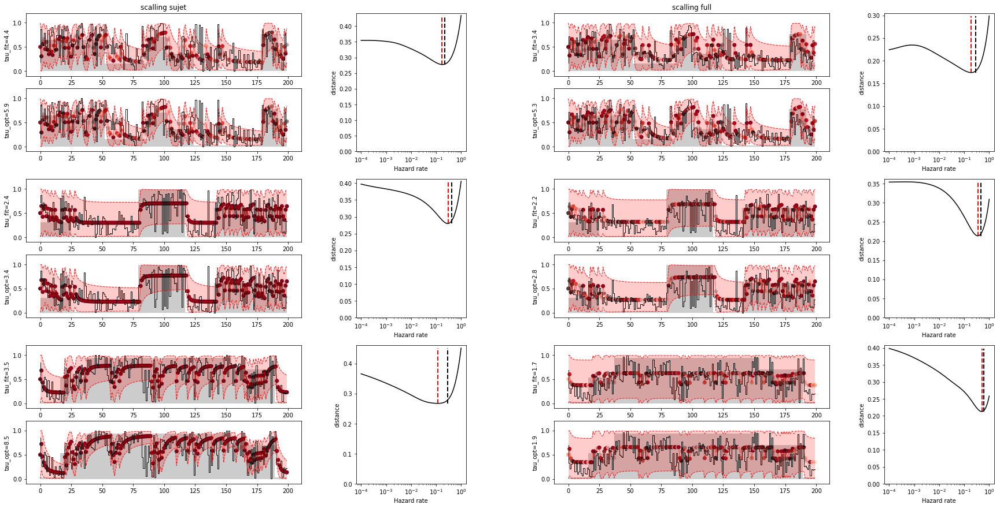

RS

scalling sujet
block 0 --> tau_fit=6.7 , h_fit=0.14842 , tau_opt=7.7 , h_opt=0.12915
block 1 --> tau_fit=10.0 , h_fit=0.10004 , tau_opt=8.5 , h_opt=0.11768
block 2 --> tau_fit=619.7 , h_fit=0.00161 , tau_opt=464.2 , h_opt=0.00215

scalling full
block 0 --> tau_fit=6.1 , h_fit=0.16505 , tau_opt=9.3 , h_opt=0.10723
block 1 --> tau_fit=5.3 , h_fit=0.18699 , tau_opt=5.9 , h_opt=0.17074
block 2 --> tau_fit=2.7 , h_fit=0.36898 , tau_opt=2.8 , h_opt=0.35938


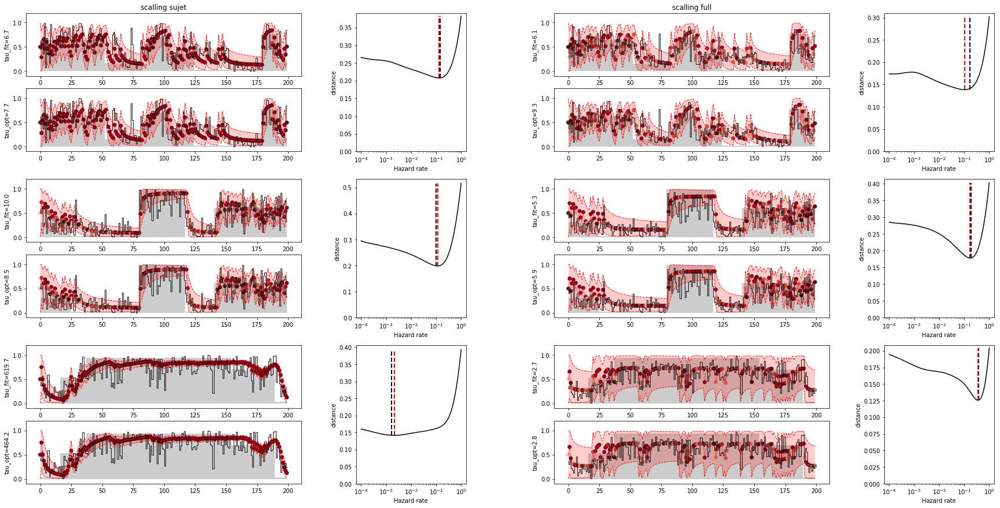

SR

scalling sujet
block 0 --> tau_fit=6.6 , h_fit=0.15103 , tau_opt=8.5 , h_opt=0.11768
block 1 --> tau_fit=8.1 , h_fit=0.12288 , tau_opt=10.2 , h_opt=0.09770
block 2 --> tau_fit=19.0 , h_fit=0.05252 , tau_opt=9.3 , h_opt=0.10723

scalling full
block 0 --> tau_fit=10.9 , h_fit=0.09150 , tau_opt=14.8 , h_opt=0.06734
block 1 --> tau_fit=8.8 , h_fit=0.11383 , tau_opt=16.3 , h_opt=0.06136
block 2 --> tau_fit=11.7 , h_fit=0.08573 , tau_opt=11.2 , h_opt=0.08902


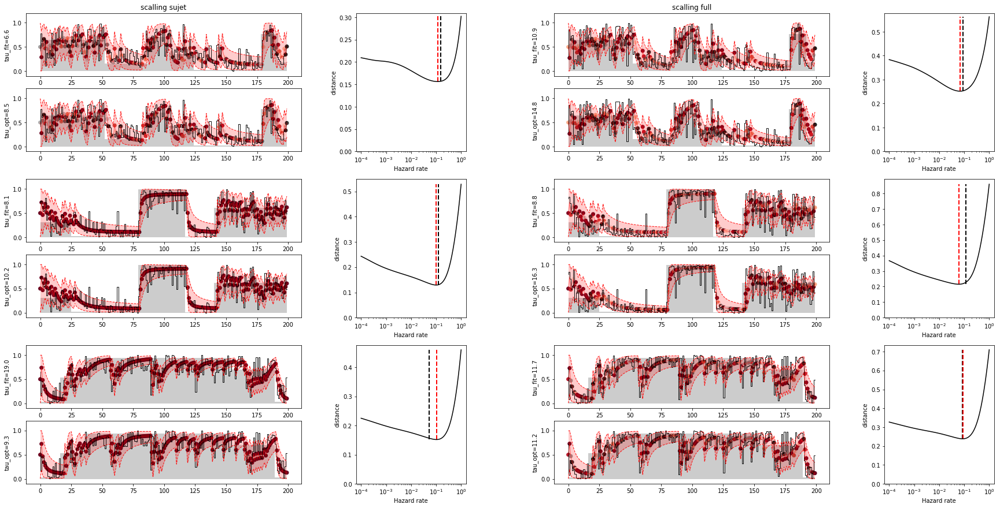

TN

scalling sujet
block 0 --> tau_fit=27.5 , h_fit=0.03639 , tau_opt=13.5 , h_opt=0.07391
block 1 --> tau_fit=6.4 , h_fit=0.15650 , tau_opt=7.7 , h_opt=0.12915
block 2 --> tau_fit=9.6 , h_fit=0.10375 , tau_opt=8.5 , h_opt=0.11768

scalling full
block 0 --> tau_fit=22.0 , h_fit=0.04541 , tau_opt=17.9 , h_opt=0.05591
block 1 --> tau_fit=9.0 , h_fit=0.11060 , tau_opt=13.5 , h_opt=0.07391
block 2 --> tau_fit=9.4 , h_fit=0.10611 , tau_opt=9.3 , h_opt=0.10723


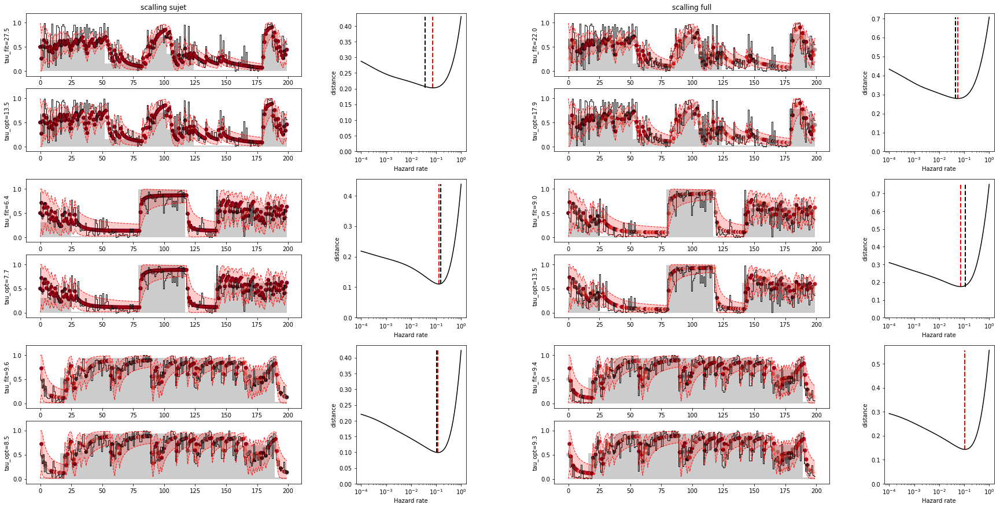

YK

scalling sujet
block 0 --> tau_fit=1.4 , h_fit=0.71638 , tau_opt=1.5 , h_opt=0.68926
block 1 --> tau_fit=2.8 , h_fit=0.35235 , tau_opt=5.3 , h_opt=0.18738
block 2 --> tau_fit=2.7 , h_fit=0.36488 , tau_opt=4.9 , h_opt=0.20565

scalling full
block 0 --> tau_fit=1.1 , h_fit=0.93479 , tau_opt=1.2 , h_opt=0.83022
block 1 --> tau_fit=2.7 , h_fit=0.37398 , tau_opt=4.0 , h_opt=0.24771
block 2 --> tau_fit=3.1 , h_fit=0.31826 , tau_opt=4.4 , h_opt=0.22570


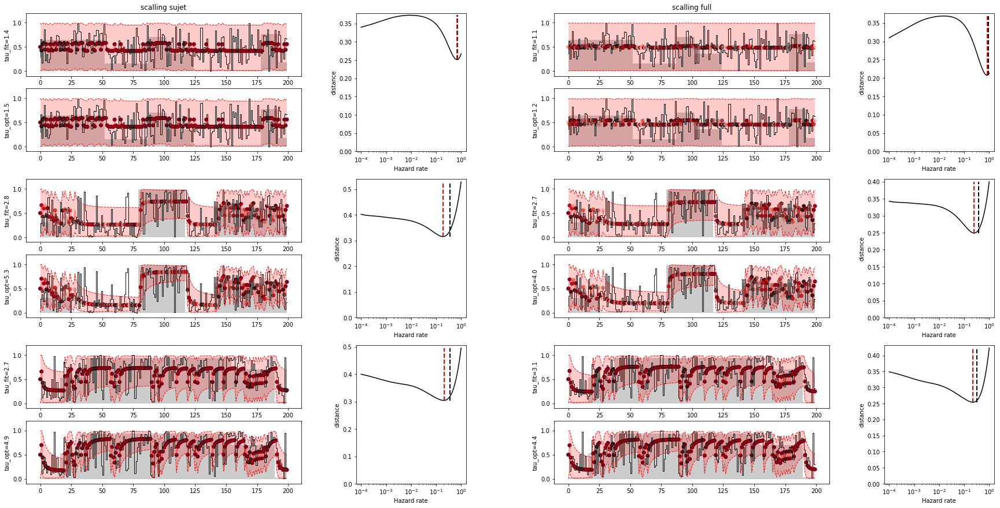

In [16]:
evaluating (new_va_sujet, new_va_full, h_va_sujet, h_va_full)

AM

scalling sujet
block 0
pause 0 --> tau_fit=19.7 , h_fit=0.05064 , tau_opt=1.6 , h_opt=0.62803
pause 1 --> tau_fit=11.5 , h_fit=0.08684 , tau_opt=3.4 , h_opt=0.29836
pause 2 --> tau_fit=63.5 , h_fit=0.01574 , tau_opt=31.3 , h_opt=0.03199
pause 3 --> tau_fit=3.4 , h_fit=0.29528 , tau_opt=4.9 , h_opt=0.20565
block 1
pause 0 --> tau_fit=10.6 , h_fit=0.09459 , tau_opt=14.8 , h_opt=0.06734
pause 1 --> tau_fit=10.5 , h_fit=0.09516 , tau_opt=14.8 , h_opt=0.06734
pause 2 --> tau_fit=4.7 , h_fit=0.21115 , tau_opt=4.9 , h_opt=0.20565
pause 3 --> tau_fit=1.3 , h_fit=0.79609 , tau_opt=1.2 , h_opt=0.83022
block 2
pause 0 --> tau_fit=69.5 , h_fit=0.01440 , tau_opt=3.4 , h_opt=0.29836
pause 1 --> tau_fit=39.5 , h_fit=0.02529 , tau_opt=49.8 , h_opt=0.02009
pause 2 --> tau_fit=83.1 , h_fit=0.01204 , tau_opt=166.8 , h_opt=0.00599
pause 3 --> tau_fit=6428.0 , h_fit=0.00016 , tau_opt=977.0 , h_opt=0.00102

scalling full
block 0
pause 0 --> tau_fit=64.0 , h_fit=0.01562 , tau_opt=37.6 , h_opt=0.02656
pau

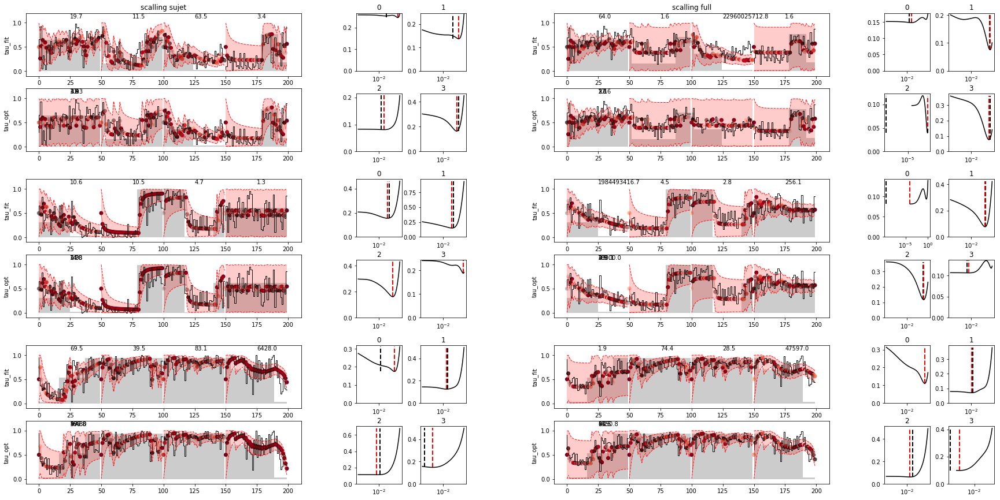

BMC

scalling sujet
block 0
pause 0 --> tau_fit=16.0 , h_fit=0.06254 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=3.3 , h_fit=0.30017 , tau_opt=3.4 , h_opt=0.29836
pause 2 --> tau_fit=19758818607.4 , h_fit=0.00000 , tau_opt=1.7 , h_opt=0.57224
pause 3 --> tau_fit=2.9 , h_fit=0.33941 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=77.6 , h_fit=0.01288 , tau_opt=31.3 , h_opt=0.03199
pause 1 --> tau_fit=9.9 , h_fit=0.10116 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=10.0 , h_fit=0.09978 , tau_opt=8.5 , h_opt=0.11768
pause 3 --> tau_fit=13.5 , h_fit=0.07401 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=3.7 , h_fit=0.27194 , tau_opt=7.7 , h_opt=0.12915
pause 1 --> tau_fit=8.6 , h_fit=0.11693 , tau_opt=10.2 , h_opt=0.09770
pause 2 --> tau_fit=29.1 , h_fit=0.03438 , tau_opt=26.0 , h_opt=0.03854
pause 3 --> tau_fit=46.9 , h_fit=0.02131 , tau_opt=45.3 , h_opt=0.02205

scalling full
block 0
pause 0 --> tau_fit=19.6 , h_fit=0.05093 , tau_opt=23.6 , h_opt=0.04229

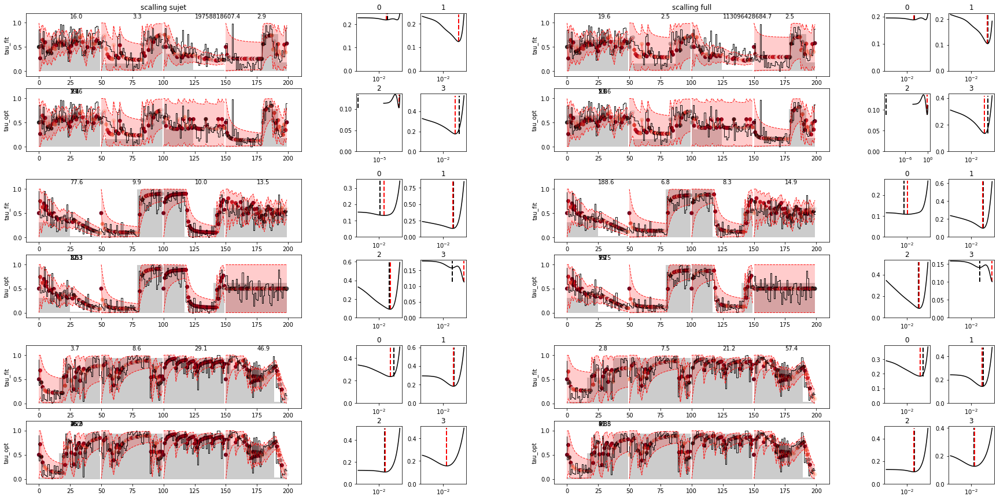

CS

scalling sujet
block 0
pause 0 --> tau_fit=2.7 , h_fit=0.36644 , tau_opt=4.9 , h_opt=0.20565
pause 1 --> tau_fit=13.1 , h_fit=0.07631 , tau_opt=10.2 , h_opt=0.09770
pause 2 --> tau_fit=45.4 , h_fit=0.02202 , tau_opt=23.6 , h_opt=0.04229
pause 3 --> tau_fit=970.4 , h_fit=0.00103 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=16.8 , h_fit=0.05949 , tau_opt=13.5 , h_opt=0.07391
pause 1 --> tau_fit=7.1 , h_fit=0.14145 , tau_opt=7.7 , h_opt=0.12915
pause 2 --> tau_fit=11.5 , h_fit=0.08731 , tau_opt=11.2 , h_opt=0.08902
pause 3 --> tau_fit=50.4 , h_fit=0.01982 , tau_opt=1.2 , h_opt=0.83022
block 2
pause 0 --> tau_fit=11.5 , h_fit=0.08712 , tau_opt=14.8 , h_opt=0.06734
pause 1 --> tau_fit=20.1 , h_fit=0.04982 , tau_opt=13.5 , h_opt=0.07391
pause 2 --> tau_fit=109.2 , h_fit=0.00915 , tau_opt=37.6 , h_opt=0.02656
pause 3 --> tau_fit=221.5 , h_fit=0.00452 , tau_opt=152.0 , h_opt=0.00658

scalling full
block 0
pause 0 --> tau_fit=22.5 , h_fit=0.04445 , tau_opt=11.2 , h_opt=0.08902


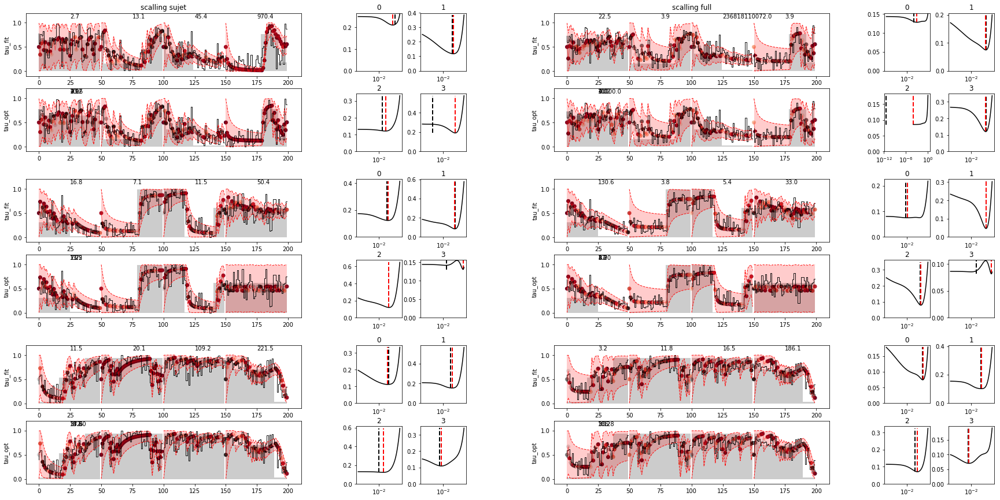

DC

scalling sujet
block 0
pause 0 --> tau_fit=13.3 , h_fit=0.07524 , tau_opt=13.5 , h_opt=0.07391
pause 1 --> tau_fit=15.7 , h_fit=0.06364 , tau_opt=13.5 , h_opt=0.07391
pause 2 --> tau_fit=3.7 , h_fit=0.27339 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=13.6 , h_fit=0.07376 , tau_opt=14.8 , h_opt=0.06734
block 1
pause 0 --> tau_fit=4.7 , h_fit=0.21412 , tau_opt=220.5 , h_opt=0.00453
pause 1 --> tau_fit=13.1 , h_fit=0.07658 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=5.7 , h_fit=0.17430 , tau_opt=6.4 , h_opt=0.15557
pause 3 --> tau_fit=1.3 , h_fit=0.74121 , tau_opt=23.6 , h_opt=0.04229
block 2
pause 0 --> tau_fit=7.6 , h_fit=0.13230 , tau_opt=9.3 , h_opt=0.10723
pause 1 --> tau_fit=4.1 , h_fit=0.24356 , tau_opt=5.3 , h_opt=0.18738
pause 2 --> tau_fit=15.9 , h_fit=0.06306 , tau_opt=23.6 , h_opt=0.04229
pause 3 --> tau_fit=6.7 , h_fit=0.14858 , tau_opt=10.2 , h_opt=0.09770

scalling full
block 0
pause 0 --> tau_fit=16.1 , h_fit=0.06196 , tau_opt=16.3 , h_opt=0.06136
pause 1 -

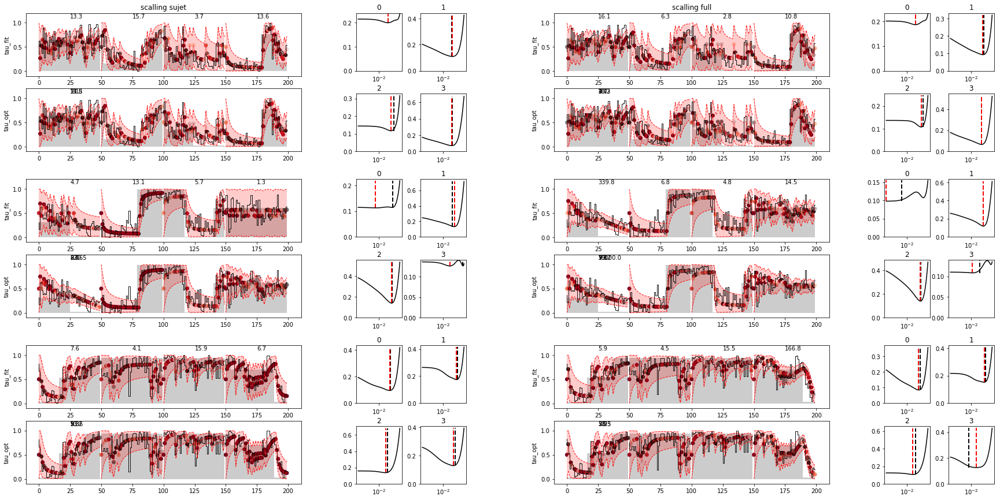

FM

scalling sujet
block 0
pause 0 --> tau_fit=738.4 , h_fit=0.00135 , tau_opt=152.0 , h_opt=0.00658
pause 1 --> tau_fit=4.3 , h_fit=0.23057 , tau_opt=3.1 , h_opt=0.32745
pause 2 --> tau_fit=63195460832.3 , h_fit=0.00000 , tau_opt=5.9 , h_opt=0.17074
pause 3 --> tau_fit=6.5 , h_fit=0.15401 , tau_opt=7.1 , h_opt=0.14175
block 1
pause 0 --> tau_fit=13.9 , h_fit=0.07193 , tau_opt=16.3 , h_opt=0.06136
pause 1 --> tau_fit=3.0 , h_fit=0.33658 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=8.2 , h_fit=0.12249 , tau_opt=12.3 , h_opt=0.08111
pause 3 --> tau_fit=150.4 , h_fit=0.00665 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=1979.5 , h_fit=0.00051 , tau_opt=811.1 , h_opt=0.00123
pause 1 --> tau_fit=38.3 , h_fit=0.02613 , tau_opt=14.8 , h_opt=0.06734
pause 2 --> tau_fit=15.4 , h_fit=0.06513 , tau_opt=19.6 , h_opt=0.05094
pause 3 --> tau_fit=9.0 , h_fit=0.11082 , tau_opt=11.2 , h_opt=0.08902

scalling full
block 0
pause 0 --> tau_fit=10.3 , h_fit=0.09709 , tau_opt=23.6 , h_opt=

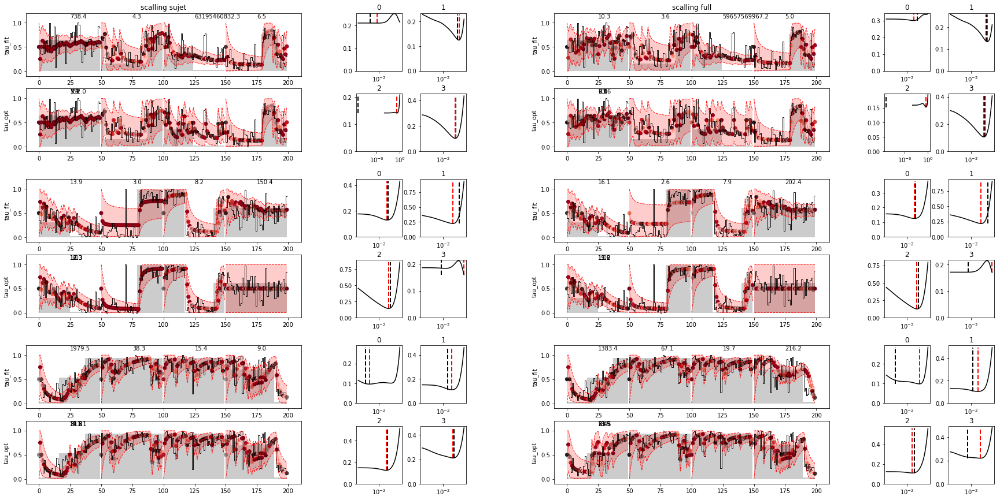

IP

scalling sujet
block 0
pause 0 --> tau_fit=9.2 , h_fit=0.10876 , tau_opt=12.3 , h_opt=0.08111
pause 1 --> tau_fit=35.8 , h_fit=0.02796 , tau_opt=4.4 , h_opt=0.22570
pause 2 --> tau_fit=19.4 , h_fit=0.05166 , tau_opt=54.6 , h_opt=0.01831
pause 3 --> tau_fit=6.6 , h_fit=0.15112 , tau_opt=7.7 , h_opt=0.12915
block 1
pause 0 --> tau_fit=20.7 , h_fit=0.04827 , tau_opt=21.5 , h_opt=0.04642
pause 1 --> tau_fit=7.4 , h_fit=0.13466 , tau_opt=7.7 , h_opt=0.12915
pause 2 --> tau_fit=7.4 , h_fit=0.13456 , tau_opt=6.4 , h_opt=0.15557
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=3.6 , h_fit=0.27756 , tau_opt=5.9 , h_opt=0.17074
pause 1 --> tau_fit=18.8 , h_fit=0.05305 , tau_opt=138.5 , h_opt=0.00722
pause 2 --> tau_fit=68.7 , h_fit=0.01455 , tau_opt=104.8 , h_opt=0.00955
pause 3 --> tau_fit=599.5 , h_fit=0.00167 , tau_opt=385.4 , h_opt=0.00260

scalling full
block 0
pause 0 --> tau_fit=9.9 , h_fit=0.10068 , tau_opt=11.2 , h_opt=0.08902
pause 1

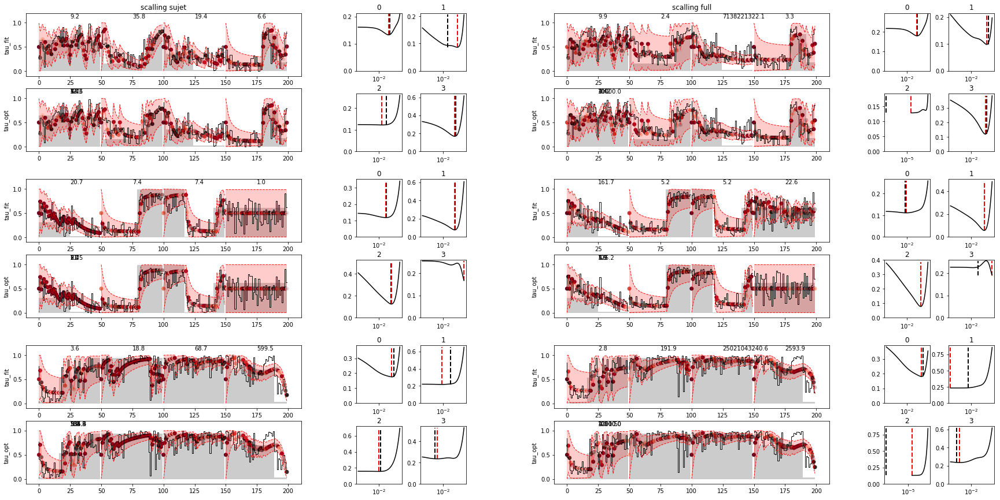

LB

scalling sujet
block 0
pause 0 --> tau_fit=15.2 , h_fit=0.06569 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=9.0 , h_fit=0.11147 , tau_opt=10.2 , h_opt=0.09770
pause 2 --> tau_fit=58.7 , h_fit=0.01703 , tau_opt=34.3 , h_opt=0.02915
pause 3 --> tau_fit=4.8 , h_fit=0.20955 , tau_opt=7.7 , h_opt=0.12915
block 1
pause 0 --> tau_fit=10.5 , h_fit=0.09511 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=7.0 , h_fit=0.14221 , tau_opt=5.9 , h_opt=0.17074
pause 2 --> tau_fit=6.5 , h_fit=0.15397 , tau_opt=9.3 , h_opt=0.10723
pause 3 --> tau_fit=1.6 , h_fit=0.63587 , tau_opt=1.2 , h_opt=0.83022
block 2
pause 0 --> tau_fit=20.7 , h_fit=0.04838 , tau_opt=3.1 , h_opt=0.32745
pause 1 --> tau_fit=41.3 , h_fit=0.02422 , tau_opt=10.2 , h_opt=0.09770
pause 2 --> tau_fit=12.2 , h_fit=0.08178 , tau_opt=14.8 , h_opt=0.06734
pause 3 --> tau_fit=16.0 , h_fit=0.06249 , tau_opt=14.8 , h_opt=0.06734

scalling full
block 0
pause 0 --> tau_fit=13.2 , h_fit=0.07589 , tau_opt=11.2 , h_opt=0.08902
pause 1 

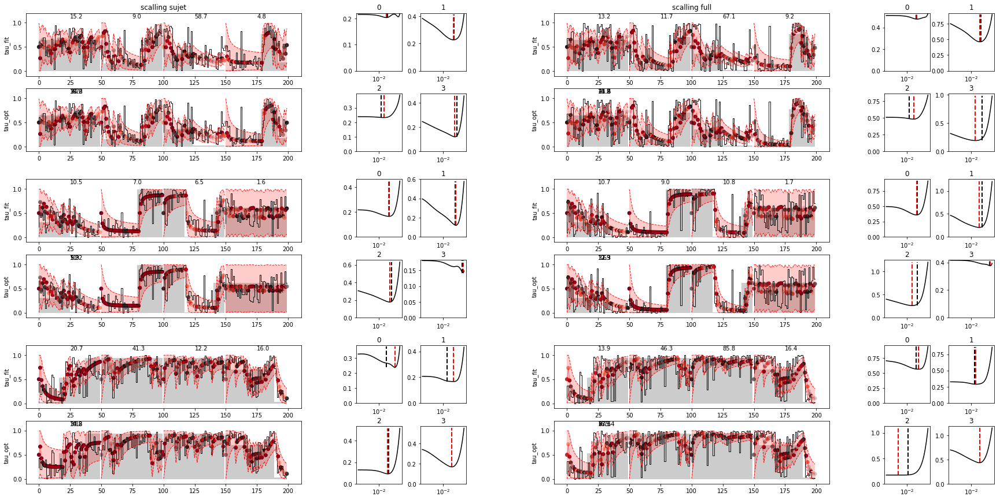

OP

scalling sujet
block 0
pause 0 --> tau_fit=10.4 , h_fit=0.09612 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=4.5 , h_fit=0.22446 , tau_opt=4.9 , h_opt=0.20565
pause 2 --> tau_fit=2.2 , h_fit=0.45261 , tau_opt=4.9 , h_opt=0.20565
pause 3 --> tau_fit=6.1 , h_fit=0.16403 , tau_opt=5.9 , h_opt=0.17074
block 1
pause 0 --> tau_fit=364.0 , h_fit=0.00275 , tau_opt=890.2 , h_opt=0.00112
pause 1 --> tau_fit=2.0 , h_fit=0.49094 , tau_opt=3.1 , h_opt=0.32745
pause 2 --> tau_fit=2.6 , h_fit=0.38456 , tau_opt=4.9 , h_opt=0.20565
pause 3 --> tau_fit=19.8 , h_fit=0.05038 , tau_opt=65.8 , h_opt=0.01520
block 2
pause 0 --> tau_fit=10.4 , h_fit=0.09645 , tau_opt=54.6 , h_opt=0.01831
pause 1 --> tau_fit=2.3 , h_fit=0.42666 , tau_opt=4.0 , h_opt=0.24771
pause 2 --> tau_fit=2.5 , h_fit=0.39998 , tau_opt=3.4 , h_opt=0.29836
pause 3 --> tau_fit=31.1 , h_fit=0.03217 , tau_opt=12.3 , h_opt=0.08111

scalling full
block 0
pause 0 --> tau_fit=24.2 , h_fit=0.04129 , tau_opt=1.2 , h_opt=0.83022
pause 1 -->

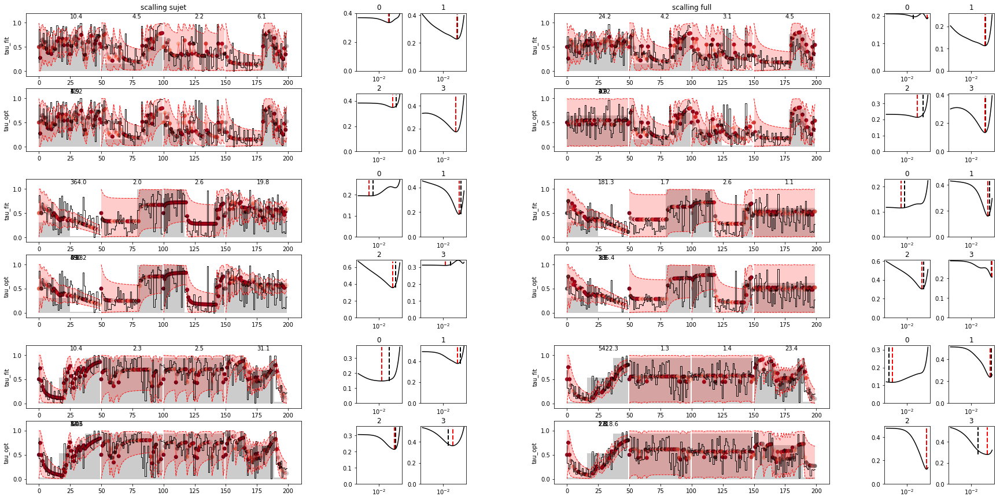

RS

scalling sujet
block 0
pause 0 --> tau_fit=11.3 , h_fit=0.08876 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=193.4 , h_fit=0.00517 , tau_opt=3.1 , h_opt=0.32745
pause 2 --> tau_fit=2.3 , h_fit=0.42760 , tau_opt=2.5 , h_opt=0.39442
pause 3 --> tau_fit=13.5 , h_fit=0.07431 , tau_opt=11.2 , h_opt=0.08902
block 1
pause 0 --> tau_fit=22.2 , h_fit=0.04508 , tau_opt=19.6 , h_opt=0.05094
pause 1 --> tau_fit=6.1 , h_fit=0.16432 , tau_opt=8.5 , h_opt=0.11768
pause 2 --> tau_fit=6.0 , h_fit=0.16568 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=197.6 , h_fit=0.00506 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=121.7 , h_fit=0.00822 , tau_opt=319.9 , h_opt=0.00313
pause 1 --> tau_fit=178.1 , h_fit=0.00561 , tau_opt=115.0 , h_opt=0.00870
pause 2 --> tau_fit=10.4 , h_fit=0.09586 , tau_opt=17.9 , h_opt=0.05591
pause 3 --> tau_fit=792.4 , h_fit=0.00126 , tau_opt=319.9 , h_opt=0.00313

scalling full
block 0
pause 0 --> tau_fit=28.0 , h_fit=0.03565 , tau_opt=41.3 , h_opt=0.0242

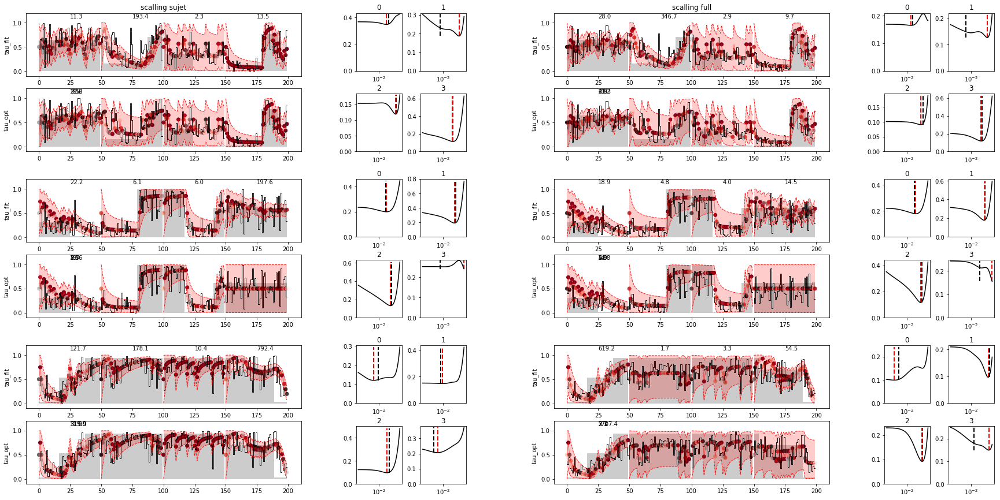

SR

scalling sujet
block 0
pause 0 --> tau_fit=91.9 , h_fit=0.01088 , tau_opt=87.0 , h_opt=0.01150
pause 1 --> tau_fit=2.9 , h_fit=0.34956 , tau_opt=3.1 , h_opt=0.32745
pause 2 --> tau_fit=3.4 , h_fit=0.29777 , tau_opt=10000.0 , h_opt=0.00010
pause 3 --> tau_fit=6.2 , h_fit=0.16047 , tau_opt=7.7 , h_opt=0.12915
block 1
pause 0 --> tau_fit=10.1 , h_fit=0.09913 , tau_opt=10.2 , h_opt=0.09770
pause 1 --> tau_fit=10.0 , h_fit=0.10043 , tau_opt=11.2 , h_opt=0.08902
pause 2 --> tau_fit=9.3 , h_fit=0.10745 , tau_opt=13.5 , h_opt=0.07391
pause 3 --> tau_fit=5.8 , h_fit=0.17168 , tau_opt=5.9 , h_opt=0.17074
block 2
pause 0 --> tau_fit=24.4 , h_fit=0.04096 , tau_opt=12.3 , h_opt=0.08111
pause 1 --> tau_fit=26.2 , h_fit=0.03816 , tau_opt=6.4 , h_opt=0.15557
pause 2 --> tau_fit=23.8 , h_fit=0.04210 , tau_opt=19.6 , h_opt=0.05094
pause 3 --> tau_fit=77.5 , h_fit=0.01290 , tau_opt=7.7 , h_opt=0.12915

scalling full
block 0
pause 0 --> tau_fit=208.4 , h_fit=0.00480 , tau_opt=49.8 , h_opt=0.02009
paus

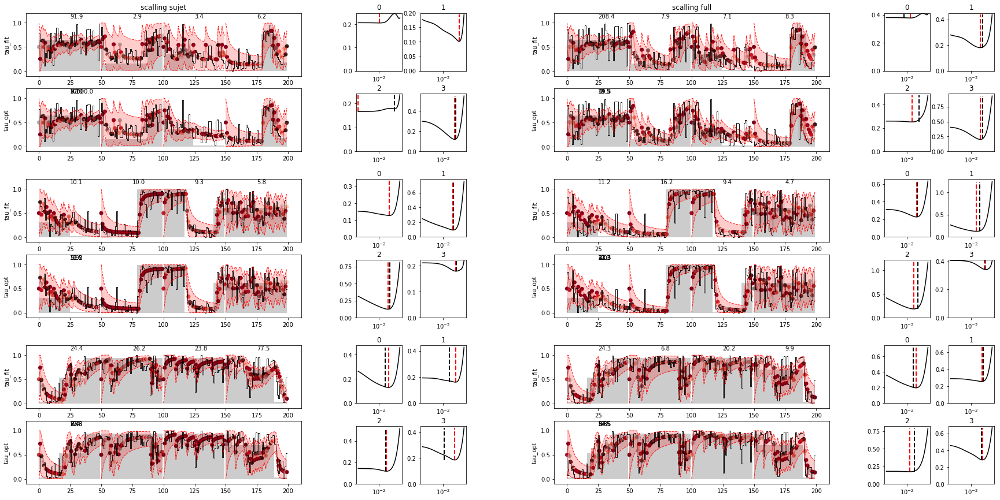

TN

scalling sujet
block 0
pause 0 --> tau_fit=2274231486.6 , h_fit=0.00000 , tau_opt=65.8 , h_opt=0.01520
pause 1 --> tau_fit=31.2 , h_fit=0.03208 , tau_opt=19.6 , h_opt=0.05094
pause 2 --> tau_fit=1.5 , h_fit=0.66633 , tau_opt=5.9 , h_opt=0.17074
pause 3 --> tau_fit=11.2 , h_fit=0.08946 , tau_opt=12.3 , h_opt=0.08111
block 1
pause 0 --> tau_fit=77.4 , h_fit=0.01292 , tau_opt=7.7 , h_opt=0.12915
pause 1 --> tau_fit=14.1 , h_fit=0.07104 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=5.8 , h_fit=0.17209 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=4.8 , h_fit=0.20794 , tau_opt=1.1 , h_opt=0.91116
block 2
pause 0 --> tau_fit=13.1 , h_fit=0.07661 , tau_opt=14.8 , h_opt=0.06734
pause 1 --> tau_fit=12.0 , h_fit=0.08344 , tau_opt=12.3 , h_opt=0.08111
pause 2 --> tau_fit=9.3 , h_fit=0.10721 , tau_opt=7.7 , h_opt=0.12915
pause 3 --> tau_fit=8.5 , h_fit=0.11728 , tau_opt=5.9 , h_opt=0.17074

scalling full
block 0
pause 0 --> tau_fit=531151687.3 , h_fit=0.00000 , tau_opt=49.8 , h_opt=0.

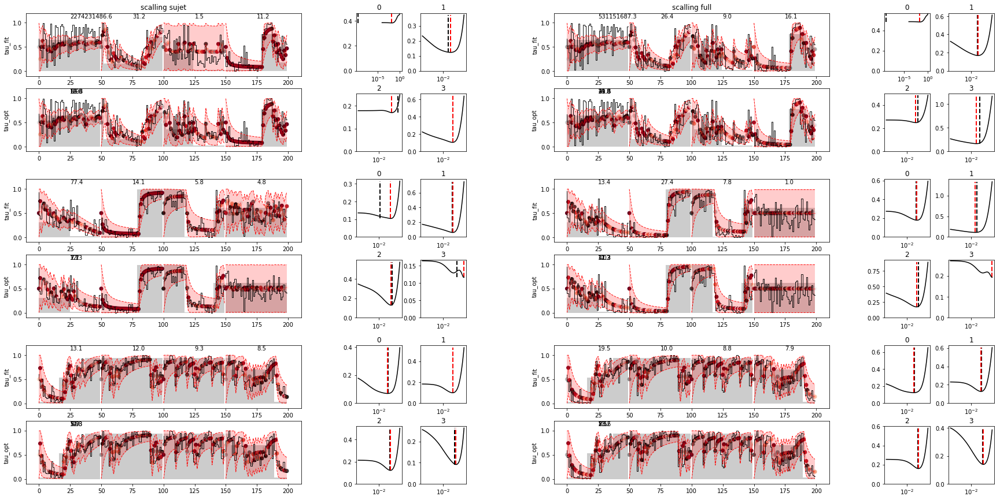

YK

scalling sujet
block 0
pause 0 --> tau_fit=21.1 , h_fit=0.04745 , tau_opt=5722.4 , h_opt=0.00017
pause 1 --> tau_fit=2.1 , h_fit=0.47897 , tau_opt=2.3 , h_opt=0.43288
pause 2 --> tau_fit=2489323124173.1 , h_fit=0.00000 , tau_opt=1.3 , h_opt=0.75646
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.2 , h_opt=0.83022
block 1
pause 0 --> tau_fit=2243034379.8 , h_fit=0.00000 , tau_opt=11.2 , h_opt=0.08902
pause 1 --> tau_fit=3.2 , h_fit=0.31700 , tau_opt=4.9 , h_opt=0.20565
pause 2 --> tau_fit=2.8 , h_fit=0.35196 , tau_opt=7.1 , h_opt=0.14175
pause 3 --> tau_fit=1.0 , h_fit=1.00000 , tau_opt=1.0 , h_opt=1.00000
block 2
pause 0 --> tau_fit=2.3 , h_fit=0.43160 , tau_opt=4.9 , h_opt=0.20565
pause 1 --> tau_fit=4.1 , h_fit=0.24276 , tau_opt=5.9 , h_opt=0.17074
pause 2 --> tau_fit=2.5 , h_fit=0.40498 , tau_opt=4.0 , h_opt=0.24771
pause 3 --> tau_fit=439.6 , h_fit=0.00227 , tau_opt=14.8 , h_opt=0.06734

scalling full
block 0
pause 0 --> tau_fit=11.0 , h_fit=0.09113 , tau_opt=265.6 , h_opt=

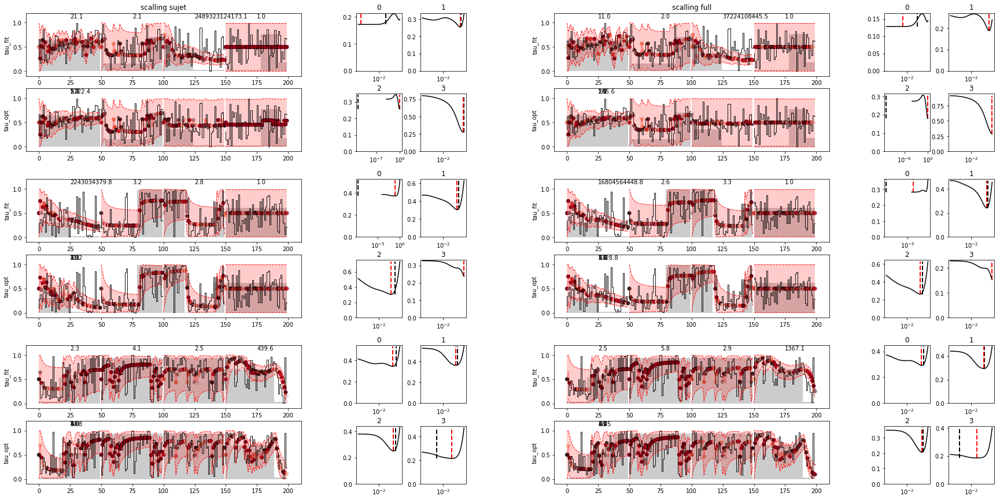

In [17]:
evaluating (new_va_sujet, new_va_full, h_va_sujet, h_va_full, show='h_pause')